# Import Dependencies

In [1]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [2]:
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import StratifiedKFold

import lightgbm as lgb
from xgboost import XGBRegressor

from pycaret.classification import *
from pycaret.regression import *

# Data Cleaning

Cleaning the Rookie of the Year dataset.

In [12]:
roys = pd.read_csv("roy_stats.csv")
roys

,Rank,Player,Age,Tm,First,Pts Won,Pts Max,Share,G,MP,...,TRB,AST,STL,BLK,FG%,3P%,FT%,WS,WS/48,Year
0,1,Larry Bird,23,BOS,63.0,63.0,66,0.955,82,36.0,...,10.4,4.5,1.7,0.6,0.474,0.406,0.836,11.2,0.182,1980
1,2,Magic Johnson,20,LAL,3.0,3.0,66,0.045,77,36.3,...,7.7,7.3,2.4,0.5,0.530,0.226,0.810,10.5,0.180,1980
2,1,Darrell Griffith,22,UTA,19.0,19.0,69,0.275,81,35.4,...,3.6,2.4,1.3,0.5,0.464,0.192,0.716,0.4,0.006,1981
3,2,Kelvin Ransey,22,POR,18.0,18.0,69,0.261,80,30.4,...,2.4,6.9,1.1,0.1,0.452,0.097,0.749,2.8,0.056,1981
4,3,Larry Smith,23,GSW,14.0,14.0,69,0.203,82,31.4,...,12.1,1.1,0.9,0.8,0.512,NaN,0.588,6.1,0.113,1981
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
754,2,Jalen Williams,21,OKC,0.0,241.0,500,0.482,75,30.3,...,4.5,3.3,1.4,0.5,0.521,0.356,0.812,5.6,0.119,2023
755,3,Walker Kessler,21,UTA,2.0,114.0,500,0.228,74,23.0,...,8.4,0.9,0.4,2.3,0.720,0.333,0.516,7.1,0.200,2023
756,4,Bennedict Mathurin,20,IND,0.0,27.0,500,0.054,78,28.5,...,4.1,1.5,0.6,0.2,0.434,0.323,0.828,1.8,0.038,2023
757,5,Keegan Murray,22,SAC,0.0,21.0,500,0.042,80,29.8,...,4.6,1.2,0.8,0.5,0.453,0.411,0.765,4.3,0.087,2023


In [13]:
roys_cleaned = roys[["Player", "Pts Won", "Pts Max", "Share", "Year"]]
roys_cleaned

,Player,Pts Won,Pts Max,Share,Year
0,Larry Bird,63.0,66,0.955,1980
1,Magic Johnson,3.0,66,0.045,1980
2,Darrell Griffith,19.0,69,0.275,1981
3,Kelvin Ransey,18.0,69,0.261,1981
4,Larry Smith,14.0,69,0.203,1981
...,...,...,...,...,...
754,Jalen Williams,241.0,500,0.482,2023
755,Walker Kessler,114.0,500,0.228,2023
756,Bennedict Mathurin,27.0,500,0.054,2023
757,Keegan Murray,21.0,500,0.042,2023


In [14]:
roys_cleaned[roys_cleaned["Player"] == "Yao Ming"]

,Player,Pts Won,Pts Max,Share,Year
85,Yao Ming,405.0,585,0.692,2003
338,Yao Ming,405.0,585,0.692,2003
591,Yao Ming,405.0,585,0.692,2003


Cleaning all rookie stats data.

In [15]:
rookies = pd.read_csv("rookie_stats.csv")
rookies

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,1,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,3,Larry Bird*,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,4,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,5,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3491,82,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,...,.513,.418,.833,21.1,6.8,2.3,1.4,0.8,0.4,2024
3492,83,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,...,.000,.000,NaN,3.0,0.0,2.5,0.5,0.0,0.0,2024
3493,84,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,...,.465,.305,.800,28.5,20.5,10.1,3.1,1.1,3.1,2024
3494,85,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,...,.475,.398,.659,16.3,10.5,3.8,0.4,0.6,0.3,2024


Delete extra overheader rows.

In [16]:
rookies = rookies[~rookies["G"].str.contains("Totals")]
rookies.head(25)

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,1,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,3,Larry Bird*,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,4,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,5,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
5,6,Bill Cartwright,"Oct 12, '79, NYK @ ATL",22,1,82,3150,665,1215,0,...,.547,NaN,.797,38.4,21.7,8.9,2.0,0.6,1.2,1980
6,7,Jeff Cook,"Oct 12, '79, PHO vs. GSW",23,1,66,904,129,275,0,...,.469,.000,.806,13.7,5.5,3.7,1.3,0.4,0.3,1980
7,8,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,...,.495,.000,.733,15.2,5.7,2.1,1.1,0.8,0.3,1980
8,9,John Coughran,"Oct 12, '79, GSW @ PHO",28,1,24,160,29,81,2,...,.358,.222,.571,6.7,2.8,0.8,0.5,0.3,0.0,1980
9,10,Terry Crosby,"Nov 13, '79, KCK vs. PHI",23,1,4,28,2,4,0,...,.500,NaN,1.000,7.0,1.5,0.3,1.8,0.0,0.0,1980


In [17]:
rookies = rookies[~rookies["Debut"].str.contains("Debut")]
rookies.head(25)

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,1,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,3,Larry Bird*,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,4,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,5,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
5,6,Bill Cartwright,"Oct 12, '79, NYK @ ATL",22,1,82,3150,665,1215,0,...,.547,NaN,.797,38.4,21.7,8.9,2.0,0.6,1.2,1980
6,7,Jeff Cook,"Oct 12, '79, PHO vs. GSW",23,1,66,904,129,275,0,...,.469,.000,.806,13.7,5.5,3.7,1.3,0.4,0.3,1980
7,8,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,...,.495,.000,.733,15.2,5.7,2.1,1.1,0.8,0.3,1980
8,9,John Coughran,"Oct 12, '79, GSW @ PHO",28,1,24,160,29,81,2,...,.358,.222,.571,6.7,2.8,0.8,0.5,0.3,0.0,1980
9,10,Terry Crosby,"Nov 13, '79, KCK vs. PHI",23,1,4,28,2,4,0,...,.500,NaN,1.000,7.0,1.5,0.3,1.8,0.0,0.0,1980


In [18]:
rookies.reset_index(drop=True, inplace = True)
rookies.head(25)

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,1,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,3,Larry Bird*,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,4,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,5,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
5,6,Bill Cartwright,"Oct 12, '79, NYK @ ATL",22,1,82,3150,665,1215,0,...,.547,NaN,.797,38.4,21.7,8.9,2.0,0.6,1.2,1980
6,7,Jeff Cook,"Oct 12, '79, PHO vs. GSW",23,1,66,904,129,275,0,...,.469,.000,.806,13.7,5.5,3.7,1.3,0.4,0.3,1980
7,8,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,...,.495,.000,.733,15.2,5.7,2.1,1.1,0.8,0.3,1980
8,9,John Coughran,"Oct 12, '79, GSW @ PHO",28,1,24,160,29,81,2,...,.358,.222,.571,6.7,2.8,0.8,0.5,0.3,0.0,1980
9,10,Terry Crosby,"Nov 13, '79, KCK vs. PHI",23,1,4,28,2,4,0,...,.500,NaN,1.000,7.0,1.5,0.3,1.8,0.0,0.0,1980


In [19]:
rookies["Player"] = rookies["Player"].str.replace("*", "", regex=False)
rookies

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,1,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,4,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,5,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3346,82,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,...,.513,.418,.833,21.1,6.8,2.3,1.4,0.8,0.4,2024
3347,83,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,...,.000,.000,NaN,3.0,0.0,2.5,0.5,0.0,0.0,2024
3348,84,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,...,.465,.305,.800,28.5,20.5,10.1,3.1,1.1,3.1,2024
3349,85,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,...,.475,.398,.659,16.3,10.5,3.8,0.4,0.6,0.3,2024


Deal with duplicate entries

In [20]:
duplicated = rookies[rookies.duplicated(subset=['Debut'])]
print ("Duplicated rows: ")
duplicated.head(50)

Duplicated rows: 


,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
7,8,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,...,.495,.000,.733,15.2,5.7,2.1,1.1,0.8,0.3,1980
12,13,Greg Deane,"Oct 12, '79, UTA @ POR",22,1,7,48,2,11,1,...,.182,1.000,.714,6.9,1.4,0.9,0.9,0.0,0.0,1980
13,14,Larry Demic,"Oct 12, '79, NYK @ ATL",22,1,82,1872,230,528,0,...,.436,NaN,.601,22.8,7.0,5.9,0.8,0.7,0.4,1980
19,20,Roy Hamilton,"Oct 12, '79, DET vs. IND",22,1,72,1116,115,287,0,...,.401,.000,.687,15.5,4.6,1.5,2.7,0.7,0.1,1980
20,21,Gerald Henderson,"Oct 12, '79, BOS vs. HOU",24,1,76,1061,191,382,2,...,.500,.333,.690,14.0,6.2,1.1,1.9,0.6,0.2,1980
21,22,Johnny High,"Oct 12, '79, PHO vs. GSW",22,1,82,1121,144,323,1,...,.446,.143,.674,13.7,5.0,2.1,1.5,0.9,0.2,1980
23,24,Phil Hubbard,"Oct 12, '79, DET vs. IND",23,1,64,1189,210,451,0,...,.466,.000,.750,18.6,9.1,5.0,1.1,0.8,0.2,1980
24,25,Geoff Huston,"Oct 12, '79, NYK @ ATL",22,1,71,923,94,241,3,...,.390,.176,.737,13.0,3.1,0.8,2.2,0.5,0.1,1980
30,31,Greg Kelser,"Oct 12, '79, DET vs. IND",22,1,50,1233,280,593,3,...,.472,.200,.719,24.7,14.2,5.5,2.2,1.2,0.7,1980
31,32,Irv Kiffin,"Oct 13, '79, SAS vs. DET",28,1,26,212,32,96,0,...,.333,NaN,.720,8.2,3.2,1.5,0.7,0.4,0.1,1980


In [21]:
rookies = rookies.drop_duplicates(subset=['Player'])
rookies.reset_index(drop=True, inplace = True)

In [22]:
rookies[rookies["Player"] == "Hollis Copeland"]

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
7,8,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,...,.495,.000,.733,15.2,5.7,2.1,1.1,0.8,0.3,1980


In [23]:
rookies

,Rk,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,1,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,4,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,5,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3324,82,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,...,.513,.418,.833,21.1,6.8,2.3,1.4,0.8,0.4,2024
3325,83,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,...,.000,.000,NaN,3.0,0.0,2.5,0.5,0.0,0.0,2024
3326,84,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,...,.465,.305,.800,28.5,20.5,10.1,3.1,1.1,3.1,2024
3327,85,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,...,.475,.398,.659,16.3,10.5,3.8,0.4,0.6,0.3,2024


Making a file for the cleaned rookie data.

In [24]:
rookies_cleaned = rookies
del rookies_cleaned["Rk"]
rookies_cleaned.head(10)

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,FG%,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,.450,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,.493,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,.474,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980
3,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,.462,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980
4,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,.452,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980
5,Bill Cartwright,"Oct 12, '79, NYK @ ATL",22,1,82,3150,665,1215,0,0,...,.547,NaN,.797,38.4,21.7,8.9,2.0,0.6,1.2,1980
6,Jeff Cook,"Oct 12, '79, PHO vs. GSW",23,1,66,904,129,275,0,3,...,.469,.000,.806,13.7,5.5,3.7,1.3,0.4,0.3,1980
7,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,2,...,.495,.000,.733,15.2,5.7,2.1,1.1,0.8,0.3,1980
8,John Coughran,"Oct 12, '79, GSW @ PHO",28,1,24,160,29,81,2,9,...,.358,.222,.571,6.7,2.8,0.8,0.5,0.3,0.0,1980
9,Terry Crosby,"Nov 13, '79, KCK vs. PHI",23,1,4,28,2,4,0,0,...,.500,NaN,1.000,7.0,1.5,0.3,1.8,0.0,0.0,1980


In [25]:
rookies_cleaned["Teams_Played"] = rookies_cleaned["Debut"].apply(lambda x: x.split(',')[2])
rookies_cleaned

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Teams_Played
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980,SEA @ SDC
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980,POR @ DET
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980,BOS vs. HOU
3,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980,WSB vs. IND
4,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980,IND @ DET
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3324,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,.418,.833,21.1,6.8,2.3,1.4,0.8,0.4,2024,OKC @ CHI
3325,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,.000,NaN,3.0,0.0,2.5,0.5,0.0,0.0,2024,BOS vs. SAS
3326,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,.305,.800,28.5,20.5,10.1,3.1,1.1,3.1,2024,SAS vs. DAL
3327,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,.398,.659,16.3,10.5,3.8,0.4,0.6,0.3,2024,HOU @ ORL


In [26]:
rookies_cleaned['Team'] = rookies_cleaned["Teams_Played"].str.split("vs. | @")
rookies_cleaned

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Teams_Played,Team
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980,SEA @ SDC,"[ SEA, SDC]"
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980,POR @ DET,"[ POR, DET]"
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980,BOS vs. HOU,"[ BOS , HOU]"
3,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980,WSB vs. IND,"[ WSB , IND]"
4,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980,IND @ DET,"[ IND, DET]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3324,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,.833,21.1,6.8,2.3,1.4,0.8,0.4,2024,OKC @ CHI,"[ OKC, CHI]"
3325,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,NaN,3.0,0.0,2.5,0.5,0.0,0.0,2024,BOS vs. SAS,"[ BOS , SAS]"
3326,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,.800,28.5,20.5,10.1,3.1,1.1,3.1,2024,SAS vs. DAL,"[ SAS , DAL]"
3327,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,.659,16.3,10.5,3.8,0.4,0.6,0.3,2024,HOU @ ORL,"[ HOU, ORL]"


In [27]:
index = rookies_cleaned.index
split_teams = pd.DataFrame(rookies_cleaned["Team"].tolist(), columns=["T1", "T2"], index=index)
split_teams


,T1,T2
0,SEA,SDC
1,POR,DET
2,BOS,HOU
3,WSB,IND
4,IND,DET
...,...,...
3324,OKC,CHI
3325,BOS,SAS
3326,SAS,DAL
3327,HOU,ORL


In [28]:
rookies_cleaned = pd.concat([rookies_cleaned, split_teams], axis=1)
rookies_cleaned

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Teams_Played,Team,T1,T2
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,4.7,2.9,0.4,0.3,0.8,1980,SEA @ SDC,"[ SEA, SDC]",SEA,SDC
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,11.3,1.8,1.9,0.9,0.1,1980,POR @ DET,"[ POR, DET]",POR,DET
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS vs. HOU,"[ BOS , HOU]",BOS,HOU
3,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,4.3,3.0,0.2,0.3,0.2,1980,WSB vs. IND,"[ WSB , IND]",WSB,IND
4,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,8.4,2.7,3.1,2.6,0.6,1980,IND @ DET,"[ IND, DET]",IND,DET
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3324,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,6.8,2.3,1.4,0.8,0.4,2024,OKC @ CHI,"[ OKC, CHI]",OKC,CHI
3325,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,0.0,2.5,0.5,0.0,0.0,2024,BOS vs. SAS,"[ BOS , SAS]",BOS,SAS
3326,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,20.5,10.1,3.1,1.1,3.1,2024,SAS vs. DAL,"[ SAS , DAL]",SAS,DAL
3327,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,10.5,3.8,0.4,0.6,0.3,2024,HOU @ ORL,"[ HOU, ORL]",HOU,ORL


In [29]:
del rookies_cleaned["Teams_Played"]
del rookies_cleaned["T2"]
del rookies_cleaned["Team"]

In [30]:
rookies_cleaned.rename(columns={'T1':'Tm'}, inplace=True)
rookies_cleaned

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,3P%,FT%,MP.1,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Tm
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,NaN,.673,10.8,4.7,2.9,0.4,0.3,0.8,1980,SEA
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,.421,.718,14.7,11.3,1.8,1.9,0.9,0.1,1980,POR
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,.406,.836,36.0,21.3,10.4,4.5,1.7,0.6,1980,BOS
3,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,NaN,.615,9.6,4.3,3.0,0.2,0.3,0.2,1980,WSB
4,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,.400,.782,24.7,8.4,2.7,3.1,2.6,0.6,1980,IND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3324,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,.418,.833,21.1,6.8,2.3,1.4,0.8,0.4,2024,OKC
3325,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,.000,NaN,3.0,0.0,2.5,0.5,0.0,0.0,2024,BOS
3326,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,.305,.800,28.5,20.5,10.1,3.1,1.1,3.1,2024,SAS
3327,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,.398,.659,16.3,10.5,3.8,0.4,0.6,0.3,2024,HOU


Merge ROY and rookie stats data into one dataframe.

In [31]:
combined_stats = rookies_cleaned.merge(roys_cleaned, how="outer", on=["Player", "Year"])
combined_stats.head(15)

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Tm,Pts Won,Pts Max,Share
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,4.7,2.9,0.4,0.3,0.8,1980,SEA,NaN,NaN,NaN
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,11.3,1.8,1.9,0.9,0.1,1980,POR,NaN,NaN,NaN
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
4,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
5,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,4.3,3.0,0.2,0.3,0.2,1980,WSB,NaN,NaN,NaN
6,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,8.4,2.7,3.1,2.6,0.6,1980,IND,NaN,NaN,NaN
7,Bill Cartwright,"Oct 12, '79, NYK @ ATL",22,1,82,3150,665,1215,0,0,...,21.7,8.9,2.0,0.6,1.2,1980,NYK,NaN,NaN,NaN
8,Jeff Cook,"Oct 12, '79, PHO vs. GSW",23,1,66,904,129,275,0,3,...,5.5,3.7,1.3,0.4,0.3,1980,PHO,NaN,NaN,NaN
9,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,2,...,5.7,2.1,1.1,0.8,0.3,1980,NYK,NaN,NaN,NaN


In [32]:
combined_stats[["Pts Won", "Pts Max", "Share"]] = combined_stats[["Pts Won", "Pts Max", "Share"]].fillna(0)
combined_stats.head(10)

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Tm,Pts Won,Pts Max,Share
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,4.7,2.9,0.4,0.3,0.8,1980,SEA,0.0,0.0,0.000
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,11.3,1.8,1.9,0.9,0.1,1980,POR,0.0,0.0,0.000
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
4,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
5,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,1,13,125,24,52,0,0,...,4.3,3.0,0.2,0.3,0.2,1980,WSB,0.0,0.0,0.000
6,Dudley Bradley,"Oct 12, '79, IND @ DET",22,1,82,2027,275,609,2,5,...,8.4,2.7,3.1,2.6,0.6,1980,IND,0.0,0.0,0.000
7,Bill Cartwright,"Oct 12, '79, NYK @ ATL",22,1,82,3150,665,1215,0,0,...,21.7,8.9,2.0,0.6,1.2,1980,NYK,0.0,0.0,0.000
8,Jeff Cook,"Oct 12, '79, PHO vs. GSW",23,1,66,904,129,275,0,3,...,5.5,3.7,1.3,0.4,0.3,1980,PHO,0.0,0.0,0.000
9,Hollis Copeland,"Oct 12, '79, NYK @ ATL",24,1,75,1142,182,368,0,2,...,5.7,2.1,1.1,0.8,0.3,1980,NYK,0.0,0.0,0.000


In [33]:
combined_stats.iloc[0]['Tm']

' SEA'

In [34]:
combined_stats["Tm"] = combined_stats["Tm"].str.strip()
combined_stats.iloc[0]['Tm']

'SEA'

In [35]:
combined_stats

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,PTS.1,TRB.1,AST.1,STL.1,BLK.1,Year,Tm,Pts Won,Pts Max,Share
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,4.7,2.9,0.4,0.3,0.8,1980,SEA,0.0,0.0,0.000
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,11.3,1.8,1.9,0.9,0.1,1980,POR,0.0,0.0,0.000
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
4,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,21.3,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,6.8,2.3,1.4,0.8,0.4,2024,OKC,0.0,0.0,0.000
3831,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,0.0,2.5,0.5,0.0,0.0,2024,BOS,0.0,0.0,0.000
3832,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,20.5,10.1,3.1,1.1,3.1,2024,SAS,0.0,0.0,0.000
3833,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,10.5,3.8,0.4,0.6,0.3,2024,HOU,0.0,0.0,0.000


Converting nicknames.txt to a csv for easier reference later.

In [44]:
nicknames = pd.read_csv("nicknames.txt", sep=",")
nicknames

,Abbreviation,Name
0,ATL,Atlanta Hawks
1,BRK,Brooklyn Nets
2,BKN,Brooklyn Nets
3,BOS,Boston Celtics
4,CHA,Charlotte Bobcats
5,CHH,Charlotte Hornets
6,CHO,Charlotte Hornets
7,CHI,Chicago Bulls
8,CLE,Cleveland Cavaliers
9,DAL,Dallas Mavericks


In [45]:
nicknames.to_csv("nicknames.csv")

Cleaning team standings data.

In [5]:
standings = pd.read_csv("team_standings.csv")
standings.head(10)

,W,L,W/L%,GB,PS/G,PA/G,SRS,Year,Team
0,61,21,0.744,—,113.5,105.7,7.37,1980,Boston Celtics*
1,59,23,0.720,2.0,109.1,104.9,4.04,1980,Philadelphia 76ers*
2,39,43,0.476,22.0,107.0,109.5,-2.27,1980,Washington Bullets*
3,39,43,0.476,22.0,114.0,115.1,-0.96,1980,New York Knicks
4,34,48,0.415,27.0,108.3,109.5,-0.98,1980,New Jersey Nets
5,50,32,0.610,—,104.5,101.6,2.83,1980,Atlanta Hawks*
6,41,41,0.500,9.0,110.8,110.6,0.27,1980,Houston Rockets*
7,41,41,0.500,9.0,119.4,119.7,-0.24,1980,San Antonio Spurs*
8,37,45,0.451,13.0,111.2,111.9,-0.54,1980,Indiana Pacers
9,37,45,0.451,13.0,114.1,113.8,0.43,1980,Cleveland Cavaliers


In [6]:
standings_cleaned = standings
standings_cleaned["Team"] = standings_cleaned["Team"].str.replace("*", "", regex=False)
standings_cleaned.head(5)

,W,L,W/L%,GB,PS/G,PA/G,SRS,Year,Team
0,61,21,0.744,—,113.5,105.7,7.37,1980,Boston Celtics
1,59,23,0.720,2.0,109.1,104.9,4.04,1980,Philadelphia 76ers
2,39,43,0.476,22.0,107.0,109.5,-2.27,1980,Washington Bullets
3,39,43,0.476,22.0,114.0,115.1,-0.96,1980,New York Knicks
4,34,48,0.415,27.0,108.3,109.5,-0.98,1980,New Jersey Nets


In [7]:
standings_cleaned.tail(5)

,W,L,W/L%,GB,PS/G,PA/G,SRS,Year,Team
1249,28,21,0.571,—,116.4,112.9,3.78,2024,New Orleans Pelicans (7)
1250,26,23,0.531,2.0,118.2,118.8,-0.40,2024,Dallas Mavericks (8)
1251,23,26,0.469,5.0,113.4,112.3,1.36,2024,Houston Rockets (11)
1252,18,32,0.360,10.5,106.9,113.1,-5.31,2024,Memphis Grizzlies (13)
1253,10,40,0.200,18.5,112.3,120.9,-8.13,2024,San Antonio Spurs (15)


In [8]:
standings_cleaned["Team"] = standings_cleaned["Team"].str.replace(r"\(.*\)","")
standings_cleaned.tail(5)

,W,L,W/L%,GB,PS/G,PA/G,SRS,Year,Team
1249,28,21,0.571,—,116.4,112.9,3.78,2024,New Orleans Pelicans
1250,26,23,0.531,2.0,118.2,118.8,-0.40,2024,Dallas Mavericks
1251,23,26,0.469,5.0,113.4,112.3,1.36,2024,Houston Rockets
1252,18,32,0.360,10.5,106.9,113.1,-5.31,2024,Memphis Grizzlies
1253,10,40,0.200,18.5,112.3,120.9,-8.13,2024,San Antonio Spurs


In [9]:
pd.isnull(standings_cleaned).sum()

W       0
L       0
W/L%    0
GB      0
PS/G    0
PA/G    0
SRS     0
Year    0
Team    0
dtype: int64

In [10]:
standings_cleaned["Team"] = standings_cleaned["Team"].apply(lambda x: str(x).replace(u'\xa0', u''))
standings_cleaned["Team"].unique()

array(['Boston Celtics', 'Philadelphia 76ers', 'Washington Bullets',
       'New York Knicks', 'New Jersey Nets', 'Atlanta Hawks',
       'Houston Rockets', 'San Antonio Spurs', 'Indiana Pacers',
       'Cleveland Cavaliers', 'Detroit Pistons', 'Milwaukee Bucks',
       'Kansas City Kings', 'Denver Nuggets', 'Chicago Bulls',
       'Utah Jazz', 'Los Angeles Lakers', 'Seattle SuperSonics',
       'Phoenix Suns', 'Portland Trail Blazers', 'San Diego Clippers',
       'Golden State Warriors', 'Dallas Mavericks',
       'Los Angeles Clippers', 'Sacramento Kings', 'Charlotte Hornets',
       'Miami Heat', 'Orlando Magic', 'Minnesota Timberwolves',
       'Toronto Raptors', 'Vancouver Grizzlies', 'Washington Wizards',
       'Memphis Grizzlies', 'New Orleans Hornets', 'Charlotte Bobcats',
       'New Orleans/Oklahoma City Hornets', 'Oklahoma City Thunder',
       'Brooklyn Nets', 'New Orleans Pelicans'], dtype=object)

In [11]:
nicknames = {}

with open("nicknames.txt") as f:
  lines = f.readlines()
  for line in lines[1:]:
    abbrev, name = line.replace("\n", "").split(",")
    nicknames[abbrev] = name

In [40]:
combined_stats["Team"] = combined_stats["Tm"].map(nicknames)
combined_stats

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,TRB.1,AST.1,STL.1,BLK.1,Year,Tm,Pts Won,Pts Max,Share,Team
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,2.9,0.4,0.3,0.8,1980,SEA,0.0,0.0,0.000,Seattle SuperSonics
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,1.8,1.9,0.9,0.1,1980,POR,0.0,0.0,0.000,Portland Trail Blazers
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955,Boston Celtics
3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955,Boston Celtics
4,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955,Boston Celtics
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,2.3,1.4,0.8,0.4,2024,OKC,0.0,0.0,0.000,Oklahoma City Thunder
3831,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,2.5,0.5,0.0,0.0,2024,BOS,0.0,0.0,0.000,Boston Celtics
3832,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,10.1,3.1,1.1,3.1,2024,SAS,0.0,0.0,0.000,San Antonio Spurs
3833,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,3.8,0.4,0.6,0.3,2024,HOU,0.0,0.0,0.000,Houston Rockets


Merge standings/team names with the stats dataframe.

In [41]:
all_stats = combined_stats.merge(standings_cleaned, how="outer", on=["Team", "Year"])
all_stats

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,Pts Max,Share,Team,W,L,W/L%,GB,PS/G,PA/G,SRS
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,1,38,325,45,115,0,1,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,1,77,1286,288,565,0,6,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,1,72,1270,189,460,1,22,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3884,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Dallas Mavericks,50,32,0.610,6.0,105.2,102.3,3.36
3885,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Milwaukee Bucks,56,17,0.767,—,118.7,108.6,9.41
3886,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Los Angeles Lakers,42,30,0.583,9.0,109.5,106.8,2.77
3887,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Phoenix Suns,45,37,0.549,3.0,113.6,111.6,2.08


In [42]:
count_nan_in_df = all_stats.isnull().sum()
print(count_nan_in_df)

Player      54
Debut       54
Age         54
Yrs         54
G           54
MP          54
FG          54
FGA         54
3P          54
3PA         54
FT          54
FTA         54
ORB         54
TRB         54
AST         54
STL         54
BLK         54
TOV         54
PF          54
PTS         54
FG%         91
3P%        762
FT%        337
MP.1        54
PTS.1       54
TRB.1       54
AST.1       54
STL.1       54
BLK.1       54
Year         0
Tm          54
Pts Won     54
Pts Max     54
Share       54
Team         0
W            0
L            0
W/L%         0
GB           0
PS/G         0
PA/G         0
SRS          0
dtype: int64


In [43]:
all_stats = all_stats.dropna(subset=['Player'])
all_stats

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,Pts Max,Share,Team,W,L,W/L%,GB,PS/G,PA/G,SRS
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,1,38,325,45,115,0,1,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,1,77,1286,288,565,0,6,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,1,72,1270,189,460,1,22,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Ben Sheppard,"Oct 25, '23, IND vs. WAS",22,1,25,257,27,74,14,47,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3831,Oscar Tshiebwe,"Dec 9, '23, IND @ LAL",24,1,6,34,8,16,0,0,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3832,Jarace Walker,"Oct 25, '23, IND vs. WAS",20,1,15,165,28,64,12,30,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3833,Dmytro Skapintsev,"Dec 23, '23, NYK vs. MIL",25,1,2,2,0,1,0,0,...,0.0,0.0,New York Knicks,32,18,0.640,6.0,115.0,109.3,5.28


In [44]:
combined_stats

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,TRB.1,AST.1,STL.1,BLK.1,Year,Tm,Pts Won,Pts Max,Share,Team
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,2.9,0.4,0.3,0.8,1980,SEA,0.0,0.0,0.000,Seattle SuperSonics
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,1.8,1.9,0.9,0.1,1980,POR,0.0,0.0,0.000,Portland Trail Blazers
2,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955,Boston Celtics
3,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955,Boston Celtics
4,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,1,82,2955,693,1463,58,143,...,10.4,4.5,1.7,0.6,1980,BOS,63.0,66.0,0.955,Boston Celtics
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Cason Wallace,"Oct 25, '23, OKC @ CHI",20,1,46,971,121,236,51,122,...,2.3,1.4,0.8,0.4,2024,OKC,0.0,0.0,0.000,Oklahoma City Thunder
3831,Jordan Walsh,"Jan 17, '24, BOS vs. SAS",19,1,2,6,0,1,0,1,...,2.5,0.5,0.0,0.0,2024,BOS,0.0,0.0,0.000,Boston Celtics
3832,Victor Wembanyama,"Oct 25, '23, SAS vs. DAL",20,1,40,1140,302,650,61,200,...,10.1,3.1,1.1,3.1,2024,SAS,0.0,0.0,0.000,San Antonio Spurs
3833,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,1,22,359,86,181,33,83,...,3.8,0.4,0.6,0.3,2024,HOU,0.0,0.0,0.000,Houston Rockets


In [45]:
all_stats.dtypes

Player      object
Debut       object
Age         object
Yrs         object
G           object
MP          object
FG          object
FGA         object
3P          object
3PA         object
FT          object
FTA         object
ORB         object
TRB         object
AST         object
STL         object
BLK         object
TOV         object
PF          object
PTS         object
FG%         object
3P%         object
FT%         object
MP.1        object
PTS.1       object
TRB.1       object
AST.1       object
STL.1       object
BLK.1       object
Year         int64
Tm          object
Pts Won    float64
Pts Max    float64
Share      float64
Team        object
W            int64
L            int64
W/L%       float64
GB          object
PS/G       float64
PA/G       float64
SRS        float64
dtype: object

In [46]:
all_stats = all_stats.apply(pd.to_numeric, errors="ignore")
all_stats.dtypes

Player      object
Debut       object
Age          int64
Yrs          int64
G            int64
MP           int64
FG           int64
FGA          int64
3P           int64
3PA          int64
FT           int64
FTA          int64
ORB          int64
TRB          int64
AST          int64
STL          int64
BLK          int64
TOV          int64
PF           int64
PTS          int64
FG%        float64
3P%        float64
FT%        float64
MP.1       float64
PTS.1      float64
TRB.1      float64
AST.1      float64
STL.1      float64
BLK.1      float64
Year         int64
Tm          object
Pts Won    float64
Pts Max    float64
Share      float64
Team        object
W            int64
L            int64
W/L%       float64
GB          object
PS/G       float64
PA/G       float64
SRS        float64
dtype: object

In [47]:
all_stats["GB"].unique()

array(['4.0', '22.0', '—', '13.0', '5.0', '36.0', '2.0', '25.0', '34.0',
       '9.0', '19.0', '27.0', '37.0', '39.0', '23.0', '21.0', '18.0',
       '3.0', '12.0', '29.0', '38.0', '24.0', '15.0', '32.0', '16.0',
       '20.0', '30.0', '40.0', '11.0', '8.0', '33.0', '28.0', '10.0',
       '31.0', '14.0', '1.0', '7.0', '17.0', '6.0', '26.0', '44.0',
       '35.0', '53.0', '45.0', '42.0', '41.0', '51.0', '47.0', '50.0',
       '46.0', '43.0', '48.0', '52.0', '20.5', '11.5', '25.5', '12.5',
       '4.5', '56.0', '1.5', '32.5', '10.5', '3.5', '22.5', '21.5',
       '18.5', '2.5', '17.5', '9.5', '8.5', '0.5', '-0.5'], dtype=object)

In [48]:
all_stats["GB"] = all_stats["GB"].str.replace("—", "0")
all_stats["GB"].unique()

array(['4.0', '22.0', '0', '13.0', '5.0', '36.0', '2.0', '25.0', '34.0',
       '9.0', '19.0', '27.0', '37.0', '39.0', '23.0', '21.0', '18.0',
       '3.0', '12.0', '29.0', '38.0', '24.0', '15.0', '32.0', '16.0',
       '20.0', '30.0', '40.0', '11.0', '8.0', '33.0', '28.0', '10.0',
       '31.0', '14.0', '1.0', '7.0', '17.0', '6.0', '26.0', '44.0',
       '35.0', '53.0', '45.0', '42.0', '41.0', '51.0', '47.0', '50.0',
       '46.0', '43.0', '48.0', '52.0', '20.5', '11.5', '25.5', '12.5',
       '4.5', '56.0', '1.5', '32.5', '10.5', '3.5', '22.5', '21.5',
       '18.5', '2.5', '17.5', '9.5', '8.5', '0.5', '-0.5'], dtype=object)

In [49]:
all_stats["GB"] = pd.to_numeric(all_stats["GB"])

In [50]:
all_stats.columns

Index(['Player', 'Debut', 'Age', 'Yrs', 'G', 'MP', 'FG', 'FGA', '3P', '3PA',
       'FT', 'FTA', 'ORB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS',
       'FG%', '3P%', 'FT%', 'MP.1', 'PTS.1', 'TRB.1', 'AST.1', 'STL.1',
       'BLK.1', 'Year', 'Tm', 'Pts Won', 'Pts Max', 'Share', 'Team', 'W', 'L',
       'W/L%', 'GB', 'PS/G', 'PA/G', 'SRS'],
      dtype='object')

In [51]:
all_stats.rename(columns={'MP.1':'MPG', 'PTS.1':'PPG','TRB.1':'RPG', 'AST.1':'APG', 'STL.1':'SPG', 'BLK.1':'BPG' }, inplace=True)
all_stats.columns

Index(['Player', 'Debut', 'Age', 'Yrs', 'G', 'MP', 'FG', 'FGA', '3P', '3PA',
       'FT', 'FTA', 'ORB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS',
       'FG%', '3P%', 'FT%', 'MPG', 'PPG', 'RPG', 'APG', 'SPG', 'BPG', 'Year',
       'Tm', 'Pts Won', 'Pts Max', 'Share', 'Team', 'W', 'L', 'W/L%', 'GB',
       'PS/G', 'PA/G', 'SRS'],
      dtype='object')

In [52]:
all_stats

,Player,Debut,Age,Yrs,G,MP,FG,FGA,3P,3PA,...,Pts Max,Share,Team,W,L,W/L%,GB,PS/G,PA/G,SRS
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,1,67,726,122,271,0,0,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,1,38,325,45,115,0,1,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,1,16,235,72,146,8,19,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,1,77,1286,288,565,0,6,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,1,72,1270,189,460,1,22,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Ben Sheppard,"Oct 25, '23, IND vs. WAS",22,1,25,257,27,74,14,47,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3831,Oscar Tshiebwe,"Dec 9, '23, IND @ LAL",24,1,6,34,8,16,0,0,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3832,Jarace Walker,"Oct 25, '23, IND vs. WAS",20,1,15,165,28,64,12,30,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3833,Dmytro Skapintsev,"Dec 23, '23, NYK vs. MIL",25,1,2,2,0,1,0,0,...,0.0,0.0,New York Knicks,32,18,0.640,6.0,115.0,109.3,5.28


In [53]:
all_stats.to_csv("player_roy_stats.csv", index=False)

# Exploratory Data Analysis

In [3]:
stats = pd.read_csv("player_roy_stats.csv")
del stats["Yrs"]
stats

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Pts Max,Share,Team,W,L,W/L%,GB,PS/G,PA/G,SRS
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,726,122,271,0,0,68,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,38,325,45,115,0,1,31,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,235,72,146,8,19,28,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,1286,288,565,0,6,161,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,1270,189,460,1,22,64,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Ben Sheppard,"Oct 25, '23, IND vs. WAS",22,25,257,27,74,14,47,9,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3831,Oscar Tshiebwe,"Dec 9, '23, IND @ LAL",24,6,34,8,16,0,0,5,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3832,Jarace Walker,"Oct 25, '23, IND vs. WAS",20,15,165,28,64,12,30,6,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3833,Dmytro Skapintsev,"Dec 23, '23, NYK vs. MIL",25,2,2,0,1,0,0,0,...,0.0,0.0,New York Knicks,32,18,0.640,6.0,115.0,109.3,5.28


In [4]:
leading_scorers = stats.groupby("Year").apply(lambda x: x.sort_values("PTS", ascending=False).head(1))

In [5]:
leading_scorers[["Player","Tm", "MP", "Year", "PTS"]]

,,Player,Tm,MP,Year,PTS
Year,,,,,,
1980,13,Bill Cartwright,NYK,3150,1980,1781
1981,113,Darrell Griffith,UTA,2867,1981,1671
1982,206,Kelly Tripucka,DET,3077,1982,1772
1983,230,Terry Cummings,SDC,2531,1983,1660
1984,318,Ralph Sampson,HOU,2693,1984,1720
1985,394,Michael Jordan,CHI,3144,1985,2313
1986,473,Xavier McDaniel,SEA,2706,1986,1404
1987,510,Ron Harper,CLE,3064,1987,1874
1988,588,Mark Jackson,NYK,3249,1988,1114


In [6]:
fig = px.bar(leading_scorers, x='Year', y='PTS',
             hover_data=['Player', 'Tm', 'MP' ], color='Tm'
             )
fig.show()

In [7]:
stats.dtypes

Player      object
Debut       object
Age          int64
G            int64
MP           int64
FG           int64
FGA          int64
3P           int64
3PA          int64
FT           int64
FTA          int64
ORB          int64
TRB          int64
AST          int64
STL          int64
BLK          int64
TOV          int64
PF           int64
PTS          int64
FG%        float64
3P%        float64
FT%        float64
MPG        float64
PPG        float64
RPG        float64
APG        float64
SPG        float64
BPG        float64
Year         int64
Tm          object
Pts Won    float64
Pts Max    float64
Share      float64
Team        object
W          float64
L          float64
W/L%       float64
GB         float64
PS/G       float64
PA/G       float64
SRS        float64
dtype: object

In [55]:
stats_num = stats
columns_to_drop = ["Player", "Debut", "Tm", "Team"]
stats_num = stats_num.drop(columns_to_drop, axis=1)
stats_num

,Age,G,MP,FG,FGA,3P,3PA,FT,FTA,ORB,...,Pts Won,Pts Max,Share,W,L,W/L%,GB,PS/G,PA/G,SRS
0,22,67,726,122,271,0,0,68,101,71,...,0.0,0.0,0.0,56,26,0.683,4.0,108.5,103.8,4.24
1,23,38,325,45,115,0,1,31,39,19,...,0.0,0.0,0.0,56,26,0.683,4.0,108.5,103.8,4.24
2,23,16,235,72,146,8,19,28,39,13,...,0.0,0.0,0.0,38,44,0.463,22.0,102.5,103.3,-0.87
3,25,77,1286,288,565,0,6,161,204,114,...,0.0,0.0,0.0,38,44,0.463,22.0,102.5,103.3,-0.87
4,22,72,1270,189,460,1,22,64,90,25,...,0.0,0.0,0.0,38,44,0.463,22.0,102.5,103.3,-0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,22,25,257,27,74,14,47,9,12,7,...,0.0,0.0,0.0,28,23,0.549,5.0,124.2,122.4,1.62
3831,24,6,34,8,16,0,0,5,6,6,...,0.0,0.0,0.0,28,23,0.549,5.0,124.2,122.4,1.62
3832,20,15,165,28,64,12,30,6,7,8,...,0.0,0.0,0.0,28,23,0.549,5.0,124.2,122.4,1.62
3833,25,2,2,0,1,0,0,0,0,0,...,0.0,0.0,0.0,32,18,0.640,6.0,115.0,109.3,5.28


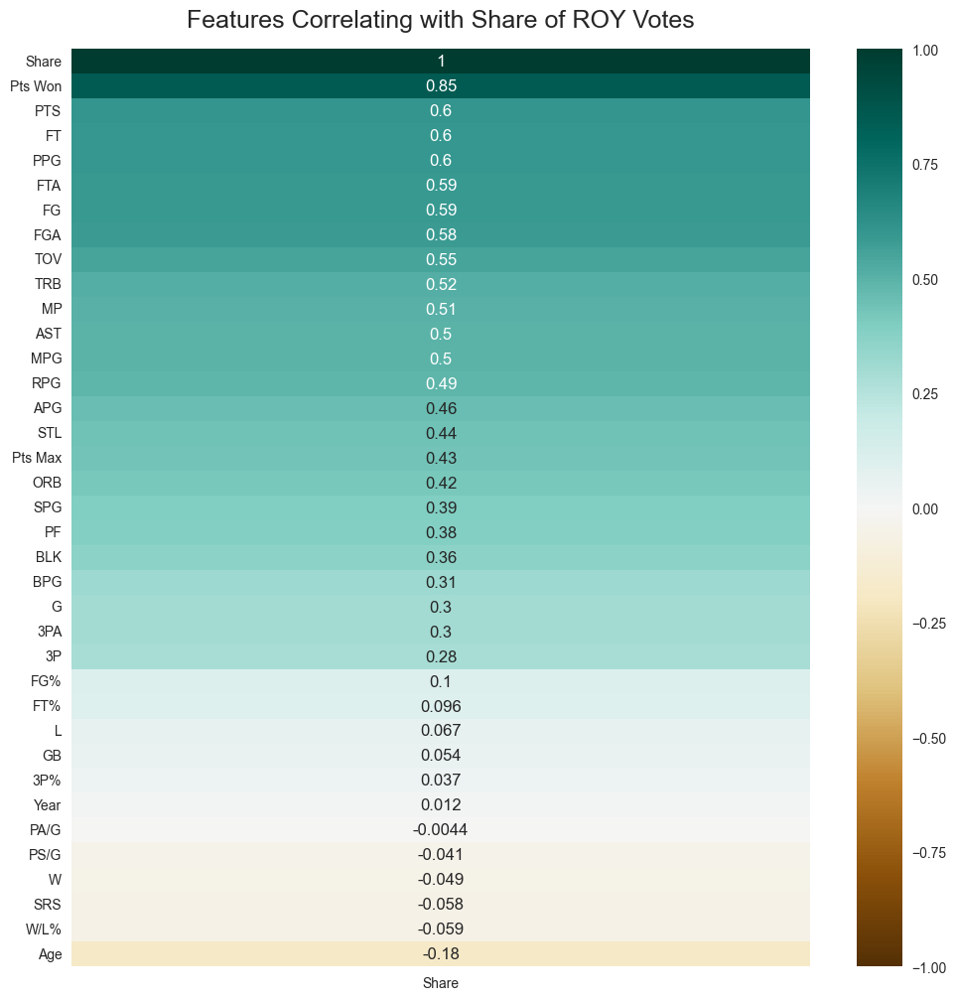

In [98]:
plt.figure(figsize=(12, 12))

heatmap = sns.heatmap(stats_num.corr()[['Share']].sort_values(by='Share', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Features Correlating with Share of ROY Votes', fontdict={'fontsize':18}, pad=16);

In [99]:
fig = px.imshow(stats_num.corr()[['Share']].sort_values(by='Share', ascending=False),
                zmin=-1,
                zmax=1
                )
fig.update_layout(width=1000,height=1000)
fig.show()

In [100]:
fig = px.imshow(stats_num.corr(),
                zmin=-1,
                zmax=1
                )
fig.update_layout(width=1000,height=1000)
fig.show()

Checking for null values and dealing with them.

In [56]:
pd.isnull(stats).sum()

Player       0
Debut        0
Age          0
G            0
MP           0
FG           0
FGA          0
3P           0
3PA          0
FT           0
FTA          0
ORB          0
TRB          0
AST          0
STL          0
BLK          0
TOV          0
PF           0
PTS          0
FG%         37
3P%        708
FT%        283
MPG          0
PPG          0
RPG          0
APG          0
SPG          0
BPG          0
Year         0
Tm           0
Pts Won      0
Pts Max      0
Share        0
Team         0
W            0
L            0
W/L%         0
GB           0
PS/G         0
PA/G         0
SRS          0
dtype: int64

In [13]:
stats[pd.isnull(stats["3P%"])][["Player", "3P", "3PA"]]

,Player,3P,3PA
0,James Bailey,0,0
9,Lawrence Boston,0,0
10,Steve Malovic,0,0
12,Tony Zeno,0,0
13,Bill Cartwright,0,0
...,...,...,...
3798,Markquis Nowell,0,0
3820,Trayce Jackson-Davis,0,0
3831,Oscar Tshiebwe,0,0
3833,Dmytro Skapintsev,0,0


In [14]:
stats[pd.isnull(stats["FG%"])][["Player", "FG", "FGA", "PTS", "MP", "FT", "FTA"]]

,Player,FG,FGA,PTS,MP,FT,FTA
460,Yvon Joseph,0,0,2,5,2,2
692,David Wood,0,0,0,2,0,0
882,Steve Bardo,0,0,0,1,0,0
919,Cedric Hunter,0,0,0,1,0,0
1190,Larry Sykes,0,0,0,2,0,0
1251,Bruce Bowen,0,0,0,1,0,0
1360,Michael McDonald,0,0,0,4,0,0
1428,Trevor Winter,0,0,0,5,0,0
1548,Andy Panko,0,0,0,1,0,0
1718,Guy Rucker,0,0,0,4,0,0


In [4]:
stats = stats.fillna(0)
stats

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Pts Max,Share,Team,W,L,W/L%,GB,PS/G,PA/G,SRS
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,726,122,271,0,0,68,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,38,325,45,115,0,1,31,...,0.0,0.0,Seattle SuperSonics,56,26,0.683,4.0,108.5,103.8,4.24
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,235,72,146,8,19,28,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,1286,288,565,0,6,161,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,1270,189,460,1,22,64,...,0.0,0.0,Portland Trail Blazers,38,44,0.463,22.0,102.5,103.3,-0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Ben Sheppard,"Oct 25, '23, IND vs. WAS",22,25,257,27,74,14,47,9,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3831,Oscar Tshiebwe,"Dec 9, '23, IND @ LAL",24,6,34,8,16,0,0,5,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3832,Jarace Walker,"Oct 25, '23, IND vs. WAS",20,15,165,28,64,12,30,6,...,0.0,0.0,Indiana Pacers,28,23,0.549,5.0,124.2,122.4,1.62
3833,Dmytro Skapintsev,"Dec 23, '23, NYK vs. MIL",25,2,2,0,1,0,0,0,...,0.0,0.0,New York Knicks,32,18,0.640,6.0,115.0,109.3,5.28


In [58]:
pd.isnull(stats).sum()

Player     0
Debut      0
Age        0
G          0
MP         0
FG         0
FGA        0
3P         0
3PA        0
FT         0
FTA        0
ORB        0
TRB        0
AST        0
STL        0
BLK        0
TOV        0
PF         0
PTS        0
FG%        0
3P%        0
FT%        0
MPG        0
PPG        0
RPG        0
APG        0
SPG        0
BPG        0
Year       0
Tm         0
Pts Won    0
Pts Max    0
Share      0
Team       0
W          0
L          0
W/L%       0
GB         0
PS/G       0
PA/G       0
SRS        0
dtype: int64

In [17]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=stats['MP']/stats['G'], 
                   histnorm='percent',
                   xbins={'start':0, 'end':45, 'size':1})
                   )
fig.show()

# Data Preprocessing

In [59]:
stats.columns

Index(['Player', 'Debut', 'Age', 'G', 'MP', 'FG', 'FGA', '3P', '3PA', 'FT',
       'FTA', 'ORB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS', 'FG%',
       '3P%', 'FT%', 'MPG', 'PPG', 'RPG', 'APG', 'SPG', 'BPG', 'Year', 'Tm',
       'Pts Won', 'Pts Max', 'Share', 'Team', 'W', 'L', 'W/L%', 'GB', 'PS/G',
       'PA/G', 'SRS'],
      dtype='object')

In [5]:
predictors = ['Age', 'G', 'MP', 'FG', 'FGA', '3P', '3PA', 'FT', 'FTA', 'ORB', 
              'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS', 'FG%', '3P%',
              'FT%', 'MPG', 'PPG', 'RPG', 'APG', 'SPG', 'BPG', 'Year',
              'W', 'L', 'W/L%', 'GB', 'PS/G', 'PA/G', 'SRS'
]

In [6]:
stat_ratios = stats[["PTS", "AST", "STL", "BLK", "3P", "FG", "TRB", "Year"]].groupby("Year", group_keys=False).apply(lambda x: x/x.mean())
stat_ratios

,PTS,AST,STL,BLK,3P,FG,TRB,Year
0,0.612713,0.226866,0.415769,2.556478,0.000000,0.610911,0.851069,1.0
1,0.237623,0.437527,0.376172,0.189369,0.000000,0.225336,0.237608,1.0
2,0.353488,0.251173,0.277180,0.094684,1.670330,0.360538,0.125284,1.0
3,1.447339,0.769723,0.791942,1.893688,0.000000,1.442151,1.166439,1.0
4,0.869974,1.166738,0.950330,0.236711,0.208791,0.946411,0.470896,1.0
...,...,...,...,...,...,...,...,...
3830,0.680576,0.912783,1.421488,0.000000,1.100548,0.638263,0.594059,1.0
3831,0.185612,0.079372,0.236915,0.000000,0.000000,0.189115,0.237624,1.0
3832,0.654060,0.793724,1.066116,0.648567,0.943327,0.661902,0.554455,1.0
3833,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0


In [7]:
stats[["PTS_Ratio", "AST_Ratio", "STL_Ratio", "BLK_Ratio", "3P_Ratio", "FG_Ratio", "TRB_Ratio"]] = stat_ratios[["PTS", "AST", "STL", "BLK", "3P", "FG", "TRB"]]
stats.head(10)

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,PS/G,PA/G,SRS,PTS_Ratio,AST_Ratio,STL_Ratio,BLK_Ratio,3P_Ratio,FG_Ratio,TRB_Ratio
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,726,122,271,0,0,68,...,108.5,103.8,4.24,0.612713,0.226866,0.415769,2.556478,0.000000,0.610911,0.851069
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,38,325,45,115,0,1,31,...,108.5,103.8,4.24,0.237623,0.437527,0.376172,0.189369,0.000000,0.225336,0.237608
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,235,72,146,8,19,28,...,102.5,103.3,-0.87,0.353488,0.251173,0.277180,0.094684,1.670330,0.360538,0.125284
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,1286,288,565,0,6,161,...,102.5,103.3,-0.87,1.447339,0.769723,0.791942,1.893688,0.000000,1.442151,1.166439
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,1270,189,460,1,22,64,...,102.5,103.3,-0.87,0.869974,1.166738,0.950330,0.236711,0.208791,0.946411,0.470896
5,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,82,2955,693,1463,58,143,301,...,113.5,105.7,7.37,3.426873,2.997868,2.831191,2.509136,12.109890,3.470175,3.680764
6,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,82,2955,693,1463,58,143,301,...,113.5,105.7,7.37,3.426873,2.997868,2.831191,2.509136,12.109890,3.470175,3.680764
7,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,82,2955,693,1463,58,143,301,...,113.5,105.7,7.37,3.426873,2.997868,2.831191,2.509136,12.109890,3.470175,3.680764
8,Gerald Henderson,"Oct 12, '79, BOS vs. HOU",24,76,1061,191,382,2,6,89,...,113.5,105.7,7.37,0.928889,1.191045,0.890934,0.710133,0.417582,0.956426,0.358572
9,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,13,125,24,52,0,0,8,...,107.0,109.5,-2.27,0.109974,0.016205,0.079194,0.094684,0.000000,0.120179,0.168486


In [8]:
predictors += ["PTS_Ratio", "AST_Ratio", "STL_Ratio", "BLK_Ratio", "3P_Ratio", "FG_Ratio", "TRB_Ratio"]

In [9]:
stats = pd.get_dummies(stats, columns = ['Tm']) 
stats

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Tm_POR,Tm_SAC,Tm_SAS,Tm_SDC,Tm_SEA,Tm_TOR,Tm_UTA,Tm_VAN,Tm_WAS,Tm_WSB
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,726,122,271,0,0,68,...,0,0,0,0,1,0,0,0,0,0
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,38,325,45,115,0,1,31,...,0,0,0,0,1,0,0,0,0,0
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,235,72,146,8,19,28,...,1,0,0,0,0,0,0,0,0,0
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,1286,288,565,0,6,161,...,1,0,0,0,0,0,0,0,0,0
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,1270,189,460,1,22,64,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3830,Ben Sheppard,"Oct 25, '23, IND vs. WAS",22,25,257,27,74,14,47,9,...,0,0,0,0,0,0,0,0,0,0
3831,Oscar Tshiebwe,"Dec 9, '23, IND @ LAL",24,6,34,8,16,0,0,5,...,0,0,0,0,0,0,0,0,0,0
3832,Jarace Walker,"Oct 25, '23, IND vs. WAS",20,15,165,28,64,12,30,6,...,0,0,0,0,0,0,0,0,0,0
3833,Dmytro Skapintsev,"Dec 23, '23, NYK vs. MIL",25,2,2,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [10]:
stats_final = stats

roty = stats_final.groupby(by = "Year").max('Share')
roty["ROTY"] = True

stats_final = stats_final.merge(roty[["Share", "ROTY"]], on = ["Year", "Share"], how = "left")
stats_final["ROTY"] = stats_final["ROTY"].fillna(value = False)

stats_final.loc[stats_final['Year'] == 2024, 'ROTY'] = False

stats_final = stats_final.drop_duplicates(subset=['Player'])
stats_final.reset_index(drop=True, inplace = True)
stats_final

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Tm_SAC,Tm_SAS,Tm_SDC,Tm_SEA,Tm_TOR,Tm_UTA,Tm_VAN,Tm_WAS,Tm_WSB,ROTY
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,726,122,271,0,0,68,...,0,0,0,1,0,0,0,0,0,False
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,38,325,45,115,0,1,31,...,0,0,0,1,0,0,0,0,0,False
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,235,72,146,8,19,28,...,0,0,0,0,0,0,0,0,0,False
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,1286,288,565,0,6,161,...,0,0,0,0,0,0,0,0,0,False
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,1270,189,460,1,22,64,...,0,0,0,0,0,0,0,0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3324,Ben Sheppard,"Oct 25, '23, IND vs. WAS",22,25,257,27,74,14,47,9,...,0,0,0,0,0,0,0,0,0,False
3325,Oscar Tshiebwe,"Dec 9, '23, IND @ LAL",24,6,34,8,16,0,0,5,...,0,0,0,0,0,0,0,0,0,False
3326,Jarace Walker,"Oct 25, '23, IND vs. WAS",20,15,165,28,64,12,30,6,...,0,0,0,0,0,0,0,0,0,False
3327,Dmytro Skapintsev,"Dec 23, '23, NYK vs. MIL",25,2,2,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,False


In [11]:
stats_final[stats_final["ROTY"] == True].sort_values(by="Year", ascending=True)

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Tm_SAC,Tm_SAS,Tm_SDC,Tm_SEA,Tm_TOR,Tm_UTA,Tm_VAN,Tm_WAS,Tm_WSB,ROTY
5,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,82,2955,693,1463,58,143,301,...,0,0,0,0,0,0,0,0,0,True
98,Darrell Griffith,"Oct 10, '80, UTA vs. POR",22,81,2867,716,1544,10,52,229,...,0,0,0,0,0,1,0,0,0,True
162,Buck Williams,"Oct 30, '81, NJN vs. NYK",21,82,2825,513,881,0,1,242,...,0,0,0,0,0,0,0,0,0,True
202,Terry Cummings,"Nov 5, '82, SDC @ MIL",21,70,2531,684,1309,0,1,292,...,0,0,1,0,0,0,0,0,0,True
284,Ralph Sampson,"Oct 29, '83, HOU vs. SAS",23,82,2693,716,1369,1,4,287,...,0,0,0,0,0,0,0,0,0,True
358,Michael Jordan,"Oct 26, '84, CHI vs. WSB",21,82,3144,837,1625,9,52,630,...,0,0,0,0,0,0,0,0,0,True
398,Patrick Ewing,"Oct 26, '85, NYK vs. PHI",23,50,1771,386,814,0,5,226,...,0,0,0,0,0,0,0,0,0,True
468,Chuck Person,"Oct 31, '86, IND @ PHI",22,82,2956,635,1358,49,138,222,...,0,0,0,0,0,0,0,0,0,True
528,Mark Jackson,"Nov 6, '87, NYK @ DET",22,82,3249,438,1013,32,126,206,...,0,0,0,0,0,0,0,0,0,True
615,Mitch Richmond,"Nov 5, '88, GSW vs. PHO",23,79,2717,649,1386,33,90,410,...,0,0,0,0,0,0,0,0,0,True


In [12]:
features = ['Age', 'G', 'MP', 'FG', 'FGA', '3P', '3PA', 'FTA', 
            'AST', 'STL', 'BLK', 'PF', 'PTS', 'FG%', '3P%', 'MPG', 
            'PPG', 'RPG', 'APG', 'SPG', 'BPG', 'Year', 'W', 'L', 'W/L%',
            'PS/G', 'PA/G', 'SRS', 'PTS_Ratio', 'AST_Ratio', 'STL_Ratio', '3P_Ratio',
            'FG_Ratio', 'TRB_Ratio', 'Tm_ATL', 'Tm_BOS', 'Tm_BRK', 'Tm_CHA', 'Tm_CHH', 
            'Tm_CHI', 'Tm_CHO', 'Tm_CLE', 'Tm_DAL', 'Tm_DEN', 'Tm_DET', 'Tm_GSW', 'Tm_HOU',
            'Tm_IND', 'Tm_KCK', 'Tm_LAC', 'Tm_LAL', 'Tm_MEM', 'Tm_MIA', 'Tm_MIL', 'Tm_MIN',
            'Tm_NJN', 'Tm_NOH', 'Tm_NOK', 'Tm_NOP', 'Tm_NYK', 'Tm_OKC', 'Tm_ORL', 'Tm_PHI',
            'Tm_PHO', 'Tm_POR', 'Tm_SAC', 'Tm_SAS', 'Tm_SDC', 'Tm_SEA', 'Tm_TOR', 'Tm_UTA', 
            'Tm_VAN', 'Tm_WAS', 'Tm_WSB'
            ]

In [13]:
columns_to_scale = ['MP', 'FG', 'FGA', '3P', '3PA', 'FT', 'FTA', 'ORB', 'TRB', 
                    'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS', 'FG%', '3P%', 'FT%', 'MPG', 
                    'PPG', 'RPG', 'APG', 'SPG', 'BPG', 'W', 'L', 'W/L%', 'GB', 'PS/G', 'PA/G', 
                    'SRS', 'PTS_Ratio', 'AST_Ratio', 'STL_Ratio', 'BLK_Ratio', '3P_Ratio','FG_Ratio', 'TRB_Ratio']

In [14]:
scaler = MinMaxScaler()

stats_final[columns_to_scale] = scaler.fit_transform(stats_final[columns_to_scale])
stats_final.head(10)

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Tm_SAC,Tm_SAS,Tm_SDC,Tm_SEA,Tm_TOR,Tm_UTA,Tm_VAN,Tm_WAS,Tm_WSB,ROTY
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,0.223453,0.145759,0.166769,0.000000,0.000000,0.107937,...,0,0,0,1,0,0,0,0,0,False
1,Vinnie Johnson,"Oct 16, '79, SEA @ PHO",23,38,0.100031,0.053763,0.070769,0.000000,0.001818,0.049206,...,0,0,0,1,0,0,0,0,0,False
2,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,0.072330,0.086022,0.089846,0.038835,0.034545,0.044444,...,0,0,0,0,0,0,0,0,0,False
3,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,0.395814,0.344086,0.347692,0.000000,0.010909,0.255556,...,0,0,0,0,0,0,0,0,0,False
4,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,0.390890,0.225806,0.283077,0.004854,0.040000,0.101587,...,0,0,0,0,0,0,0,0,0,False
5,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,82,0.909511,0.827957,0.900308,0.281553,0.260000,0.477778,...,0,0,0,0,0,0,0,0,0,True
6,Gerald Henderson,"Oct 12, '79, BOS vs. HOU",24,76,0.326562,0.228196,0.235077,0.009709,0.010909,0.141270,...,0,0,0,0,0,0,0,0,0,False
7,Lawrence Boston,"Mar 2, '80, WSB vs. IND",23,13,0.038473,0.028674,0.032000,0.000000,0.000000,0.012698,...,0,0,0,0,0,0,0,0,1,False
8,Steve Malovic,"Nov 3, '79, WSB vs. BOS",23,39,0.136965,0.037037,0.041231,0.000000,0.000000,0.028571,...,0,0,0,0,0,0,0,0,1,False
9,Dudley Bradley,"Oct 12, '79, IND @ DET",22,82,0.623884,0.328554,0.374769,0.009709,0.009091,0.215873,...,0,0,0,0,0,0,0,0,0,False


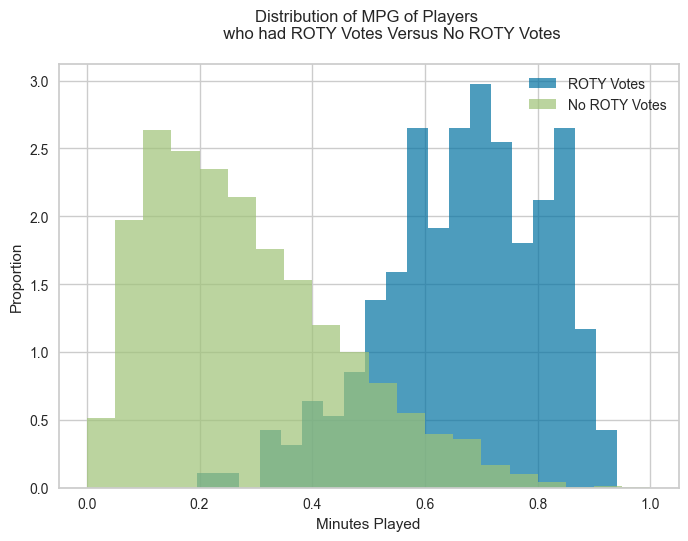

The cutoff is 0.243 minutes per game


In [15]:
royShares = stats_final[stats_final["Share"] > 0]
nonRoyShares = stats_final[stats_final["Share"] == 0]

plt.hist(royShares["MPG"], bins = 20, alpha = 0.7, density=True, label = "ROTY Votes")
plt.hist(nonRoyShares["MPG"], bins = 20, alpha = 0.7, density=True, label = "No ROTY Votes")
plt.ylabel("Proportion")
plt.xlabel("Minutes Played")
plt.title("""Distribution of MPG of Players 
          who had ROTY Votes Versus No ROTY Votes
          """)
plt.legend()
plt.show()

mp_cutoff = royShares["MPG"].mean() - 3*royShares["MPG"].std()
print(f"The cutoff is {mp_cutoff:.3f} minutes per game")

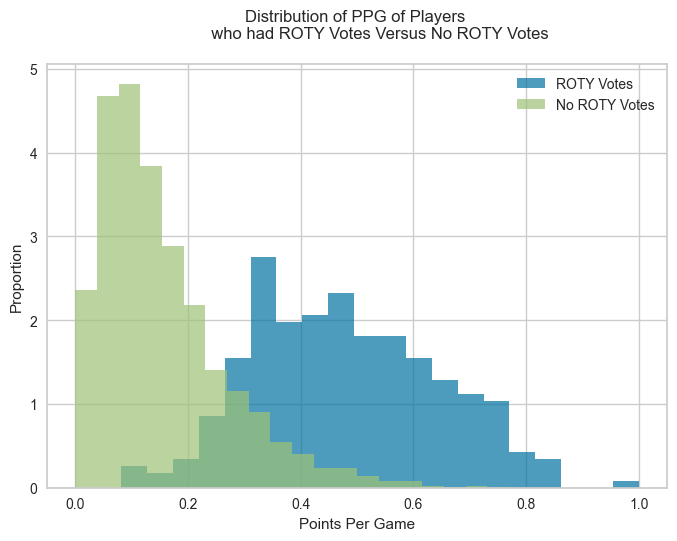

The cutoff is 0.146 points in a game


In [16]:
plt.hist(royShares["PPG"], bins = 20, alpha = 0.7, density=True, label = "ROTY Votes")
plt.hist(nonRoyShares["PPG"], bins = 20, alpha = 0.7, density=True, label = "No ROTY Votes")
plt.xlabel("Points Per Game")
plt.ylabel("Proportion")
plt.title("""Distribution of PPG of Players 
          who had ROTY Votes Versus No ROTY Votes
          """)
plt.legend()
plt.show()

pts_cutoff = royShares["PPG"].mean() - 2 * royShares["PPG"].std()
print(f"The cutoff is {pts_cutoff:.3f} points in a game")

In [17]:
stats_final = stats_final[(stats_final["PPG"] > pts_cutoff) & (stats_final["MPG"] > mp_cutoff)].reset_index(drop = True)
stats_final

,Player,Debut,Age,G,MP,FG,FGA,3P,3PA,FT,...,Tm_SAC,Tm_SAS,Tm_SDC,Tm_SEA,Tm_TOR,Tm_UTA,Tm_VAN,Tm_WAS,Tm_WSB,ROTY
0,James Bailey,"Oct 14, '79, SEA @ SDC",22,67,0.223453,0.145759,0.166769,0.000000,0.000000,0.107937,...,0,0,0,1,0,0,0,0,0,False
1,Billy Ray Bates,"Feb 23, '80, POR @ DET",23,16,0.072330,0.086022,0.089846,0.038835,0.034545,0.044444,...,0,0,0,0,0,0,0,0,0,False
2,Abdul Jeelani,"Oct 12, '79, POR vs. UTA",25,77,0.395814,0.344086,0.347692,0.000000,0.010909,0.255556,...,0,0,0,0,0,0,0,0,0,False
3,Jim Paxson,"Oct 12, '79, POR vs. UTA",22,72,0.390890,0.225806,0.283077,0.004854,0.040000,0.101587,...,0,0,0,0,0,0,0,0,0,False
4,Larry Bird,"Oct 12, '79, BOS vs. HOU",23,82,0.909511,0.827957,0.900308,0.281553,0.260000,0.477778,...,0,0,0,0,0,0,0,0,0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,Brandin Podziemski,"Oct 30, '23, GSW @ NOP",20,37,0.280086,0.161290,0.179692,0.228155,0.220000,0.036508,...,0,0,0,0,0,0,0,0,0,False
1464,Jaime Jaquez Jr.,"Oct 25, '23, MIA vs. DET",22,40,0.370268,0.254480,0.256000,0.203883,0.214545,0.134921,...,0,0,0,0,0,0,0,0,0,False
1465,Amen Thompson,"Oct 25, '23, HOU @ ORL",21,26,0.132041,0.076464,0.083077,0.029126,0.060000,0.053968,...,0,0,0,0,0,0,0,0,0,False
1466,Cam Whitmore,"Oct 25, '23, HOU @ ORL",19,22,0.110496,0.102748,0.111385,0.160194,0.150909,0.042857,...,0,0,0,0,0,0,0,0,0,False


In [22]:
#del stats["Debut"]
#del stats["TOV"]
#del stats["TRB"]
#del stats["ORB"]
#del stats["FT%"]
#del stats["FT"]
#del stats["GB"]
#del stats["BLK_Ratio"]

In [32]:
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

In [18]:
train = stats_final[stats_final["Year"] < 2023]
test = stats_final[stats_final["Year"] == 2023]

In [19]:
X = train[features]
y = train["ROTY"]

X_test = test[features]

# Baseline Random Forest Model

In [54]:
def avg_precision(compare_preds):
  actual = compare_preds.sort_values("ROTY", ascending=False).head(5)
  predicted = compare_preds.sort_values("Predictions", ascending=False)
  scores = []
  found = 0
  seen = 1
  for index, row in predicted.iterrows():
    if row["Player"] in actual["Player"].values:
      found += 1
      scores.append(found/seen)
    else:
      seen += 1
  return sum(scores) / len(scores)

In [55]:
def add_ranks(compare_preds):
  compare_preds = compare_preds.sort_values("ROTY", ascending=False)
  compare_preds["Rank"] = list(range(1, compare_preds.shape[0]+1))
  compare_preds = compare_preds.sort_values("Predictions", ascending=False)
  compare_preds["Predicted Decision"] = list(range(1, compare_preds.shape[0]+1))
  compare_preds["Diff"] = compare_preds["Rank"] - compare_preds["Predicted Decision"]
  return compare_preds

In [56]:
bt_years = list(range(1980,2025))

In [70]:
def backtest(stats_final, model, bt_year, predictors):
  ap_scores = []
  all_preds = []
  for bt_year in bt_years[5:]:
    bt_train = stats_final[stats_final["Year"] < bt_year]
    bt_test = stats_final[stats_final["Year"] == bt_year]
    model.fit(bt_train[predictors], bt_train["ROTY"])
    predictions = model.predict(bt_test[predictors])
    predictions = pd.DataFrame(predictions, columns=["Predictions"], index=bt_test.index)
    comparison = pd.concat([bt_test[["Player", "Team", "Year", "ROTY"]], predictions], axis=1)
    all_preds.append(comparison)
    ap_scores.append(avg_precision(comparison))
  return sum(ap_scores) / len(ap_scores), ap_scores, pd.concat(all_preds)

In [58]:
rfr = RandomForestRegressor(n_estimators=400, random_state=1, min_samples_split=7)

In [107]:
ap_scores = []
all_preds = []
rfr.fit(X, y)
predictions = rfr.predict(X_test)
predictions = pd.DataFrame(predictions, columns=["Predictions"], index=test.index)
comparison = pd.concat([test[["Player", "ROTY"]], predictions], axis=1)
comparison = add_ranks(comparison)
all_preds.append(comparison)
ap_scores.append(avg_precision(comparison))
sum(ap_scores) / len(ap_scores)

0.7

In [49]:
rfr_preds = pd.concat(all_preds)
rfr_preds.head(10)

,Player,ROTY,Predictions,Rank,Predicted Decision,Diff
1408,Paolo Banchero,True,0.514914,1,1,0
1418,Bennedict Mathurin,False,0.196872,33,2,31
1435,RaiQuan Gray,False,0.132781,14,3,11
1414,Jaden Ivey,False,0.092811,28,4,24
1419,Andrew Nembhard,False,0.036473,34,5,29
1434,Keegan Murray,False,0.034239,13,6,7
1413,Jalen Duren,False,0.020011,21,7,14
1432,Jalen Williams,False,0.019023,10,8,2
1429,Jabari Smith Jr.,False,0.013333,8,9,-1
1407,Walker Kessler,False,0.004940,23,10,13


In [108]:
mean_ap, ap, all_preds = backtest(stats, rfr, bt_years, predictors)
mean_ap

KeyError: 'ROTY'

In [60]:
all_preds.head(15)   

AttributeError: 'list' object has no attribute 'head'

# Baseline XGBoost Regressor Model

In [109]:
xgb_r = XGBRegressor(objective ='binary:logistic',
                  n_estimators = 10, seed = 123,
                  eval_metric=mean_absolute_error)
xgb_r.fit(X, y)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False,
             eval_metric=<function mean_absolute_error at 0x000001DBCCE70AE0>,
             feature_types=None, gamma=None, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=None, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=10,
             n_jobs=None, num_parallel_tree=None, objective='binary:logistic', ...)

In [110]:
preds = xgb_r.predict(X_test)
preds = pd.DataFrame(preds, columns=["Prediction"], index=test.index)
comparison = pd.concat([test[["Player", "Team", "ROTY"]], preds], axis=1)
comparison = comparison.sort_values("ROTY", ascending=False)
comparison.head(1)

,Player,Team,ROTY,Prediction
1408,Paolo Banchero,Orlando Magic,True,0.502159


In [111]:
xgb_predictions = xgb_r.predict(X_test)
xgb_predictions = pd.DataFrame(xgb_predictions, columns=["Predictions"], index=test.index)
comparison_xgb = pd.concat([test[["Player", "ROTY", "Year"]], xgb_predictions], axis=1)
comparison_xgb = comparison_xgb.sort_values("ROTY", ascending=False)
comparison_xgb["Rank"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_xgb = comparison_xgb.sort_values("Predictions", ascending=False)
comparison_xgb["Predicted Decision"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_xgb.head(10)

,Player,ROTY,Year,Predictions,Rank,Predicted Decision
1408,Paolo Banchero,True,2023,0.502159,1,1
1414,Jaden Ivey,False,2023,0.092343,28,2
1435,RaiQuan Gray,False,2023,0.070239,14,3
1418,Bennedict Mathurin,False,2023,0.031274,33,4
1434,Keegan Murray,False,2023,0.025246,13,5
1419,Andrew Nembhard,False,2023,0.015478,34,6
1412,MarJon Beauchamp,False,2023,0.012821,27,7
1413,Jalen Duren,False,2023,0.012658,21,8
1432,Jalen Williams,False,2023,0.012437,10,9
1429,Jabari Smith Jr.,False,2023,0.010335,8,10


In [112]:
avg_precision(comparison_xgb)

0.7043478260869566

# PyCaret Analysis

In [60]:
s = setup(
    data=X,
    test_data=X_test,
    target='ROTY',
    numeric_imputation=0,
    ignore_features=['Debut', 'Yrs', 'Player', 'Tm', 'Team', 'Pts Won', 'Pts Max', 'Share'],
    normalize=True,
    normalize_method='minmax',
    data_split_stratify=False,
    use_gpu=True
)

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 1, number of negative: 1
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Warning] Using sparse features with CUDA is currently not supported.
[LightGBM] [Info] Number of positive: 1, number of negative: 1
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 1, number of negative: 1
[LightGBM] [Warning] There are no meaningful features which satisfy the prov

,Description,Value
0,Session id,1927
1,Target,ROTY
2,Target type,Binary
3,Original data shape,"(3243, 50)"
4,Transformed data shape,"(3243, 42)"
5,Transformed train set shape,"(3158, 42)"
6,Transformed test set shape,"(85, 42)"
7,Ignore features,8
8,Numeric features,41
9,Preprocess,True


[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 1, number of negative: 1
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Warning] Using sparse features with CUDA is currently not supported.
[LightGBM] [Info] Number of positive: 1, number of negative: 1
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 1, number of negative: 1
[LightGBM] [Warning] There are no meaningful features which satisfy the prov

In [61]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9899,0.9905,0.4650,0.8400,0.5455,0.5412,0.5900,0.0850
lr,Logistic Regression,0.9896,0.9921,0.4300,0.8083,0.5310,0.5265,0.5665,0.0340
svm,SVM - Linear Kernel,0.9892,0.0000,0.5600,0.7650,0.5890,0.5843,0.6193,0.0190
xgboost,Extreme Gradient Boosting,0.9880,0.9898,0.4800,0.6542,0.5315,0.5257,0.5430,0.1990
ridge,Ridge Classifier,0.9870,0.0000,0.1200,0.4500,0.1867,0.1848,0.2285,0.0190
et,Extra Trees Classifier,0.9864,0.9902,0.2700,0.6367,0.3433,0.3382,0.3864,0.1420
qda,Quadratic Discriminant Analysis,0.9858,0.5801,0.0000,0.0000,0.0000,0.0000,0.0000,0.0260
dummy,Dummy Classifier,0.9858,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0170
rf,Random Forest Classifier,0.9854,0.9783,0.3550,0.5783,0.3957,0.3899,0.4213,0.1650
ada,Ada Boost Classifier,0.9851,0.9852,0.4200,0.5600,0.4386,0.4320,0.4554,0.3300


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=1927, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

Top 3 models to consider:
1. SVM

   The third best model, but further data pre-processing and hyperparameter tuning could improve this model significantly.  


2. Logistic Regression

   This model has the comparable accuracy as LGBM. Precision is also not too far off.


3. LGBM

   As the best model, some hyperparameter tuning would be used to get the best possible Precision score, even if it's not by a significant amount.  


Precision is the key metric to examine here, it is more useful to emphasize picking the Rookie of the Year accurately. 

In [85]:
svm = create_model('svm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9905,0.0000,0.2500,1.0000,0.4000,0.3969,0.4976
1,0.9905,0.0000,0.7500,0.6000,0.6667,0.6619,0.6662
2,0.9937,0.0000,0.5000,1.0000,0.6667,0.6638,0.7049
3,0.9905,0.0000,0.4000,1.0000,0.5714,0.5675,0.6294
4,0.9937,0.0000,0.8000,0.8000,0.8000,0.7968,0.7968
5,0.9937,0.0000,0.6000,1.0000,0.7500,0.7470,0.7721
6,0.9842,0.0000,0.2000,0.5000,0.2857,0.2792,0.3097
7,0.9937,0.0000,0.6000,1.0000,0.7500,0.7470,0.7721
8,0.9810,0.0000,0.7500,0.3750,0.5000,0.4914,0.5223


In [63]:
lr = create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9905,0.9872,0.5000,0.6667,0.5714,0.5667,0.5727
1,0.9873,0.9896,0.5000,0.5000,0.5000,0.4936,0.4936
2,0.9937,0.9968,0.5000,1.0000,0.6667,0.6638,0.7049
3,0.9873,0.9878,0.4000,0.6667,0.5000,0.4940,0.5106
4,0.9905,0.9974,0.6000,0.7500,0.6667,0.6619,0.6662
5,0.9905,0.9929,0.4000,1.0000,0.5714,0.5675,0.6294
6,0.9873,0.9936,0.2000,1.0000,0.3333,0.3298,0.4444
7,0.9873,0.9987,0.2000,1.0000,0.3333,0.3298,0.4444
8,0.9873,0.9815,0.5000,0.5000,0.5000,0.4936,0.4936


In [91]:
lgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9905,0.9904,0.2500,1.0000,0.4000,0.3969,0.4976
1,0.9905,0.9960,0.7500,0.6000,0.6667,0.6619,0.6662
2,0.9937,0.9960,0.5000,1.0000,0.6667,0.6638,0.7049
3,0.9842,0.9788,0.6000,0.5000,0.5455,0.5375,0.5398
4,0.9937,0.9974,0.8000,0.8000,0.8000,0.7968,0.7968
5,0.9905,0.9871,0.4000,1.0000,0.5714,0.5675,0.6294
6,0.9873,0.9942,0.2000,1.0000,0.3333,0.3298,0.4444
7,0.9905,1.0000,0.4000,1.0000,0.5714,0.5675,0.6294
8,0.9873,0.9743,0.5000,0.5000,0.5000,0.4936,0.4936


Observing learning curves between the 3 models.

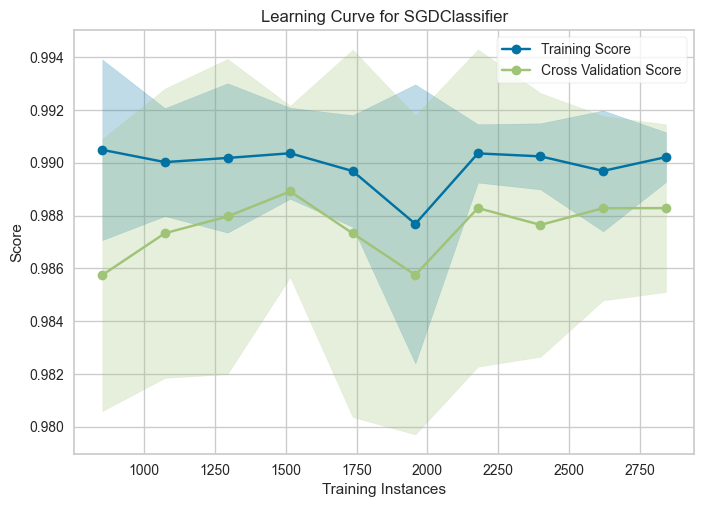

In [86]:
plot_model(estimator=svm, plot='learning')

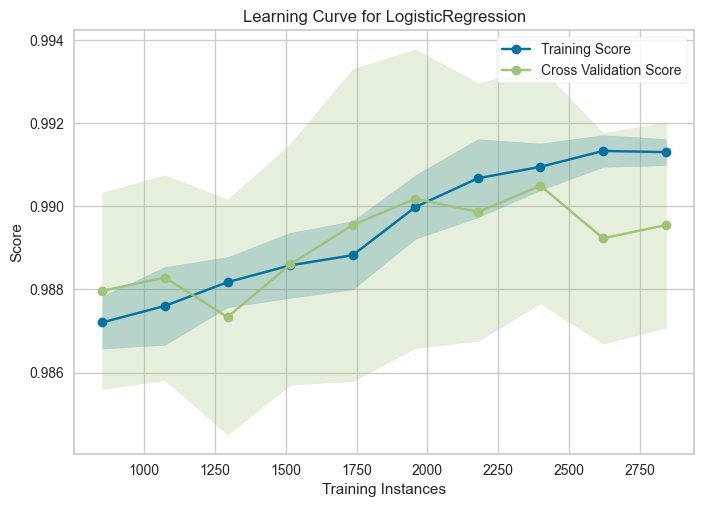

In [80]:
plot_model(estimator=lr, plot='learning')

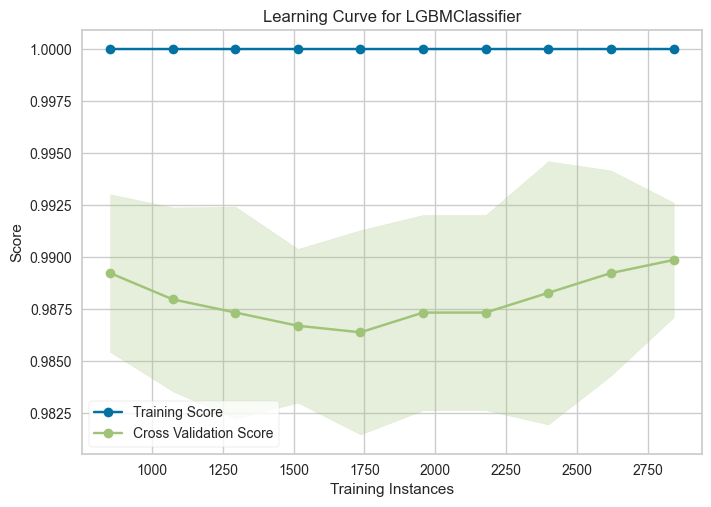

In [92]:
plot_model(estimator=lgbm, plot='learning')

The LGBM model does seem to be overfitting on the training set. The Logistic Regression model does seem to be "learning" the best out of the 3. The cross validation scores seem promising as well, especially in the LGBM model.

Observing confusion matricies between the 3 models.

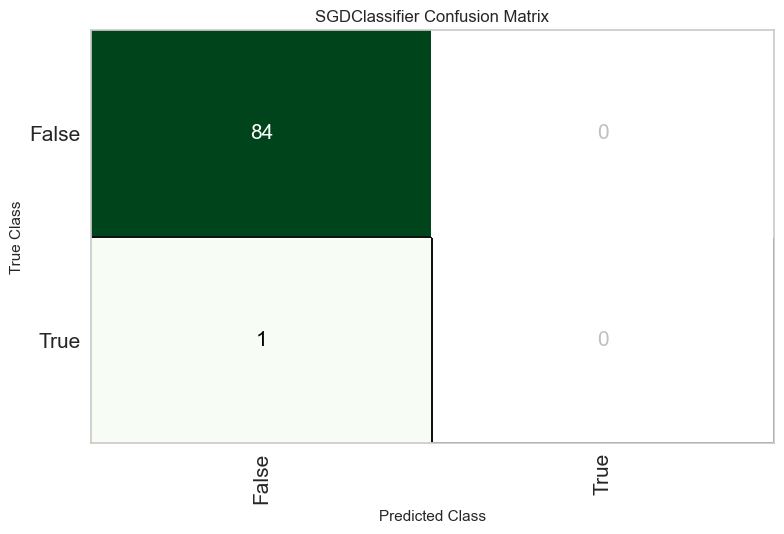

In [87]:
plot_model(estimator=svm, plot='confusion_matrix')

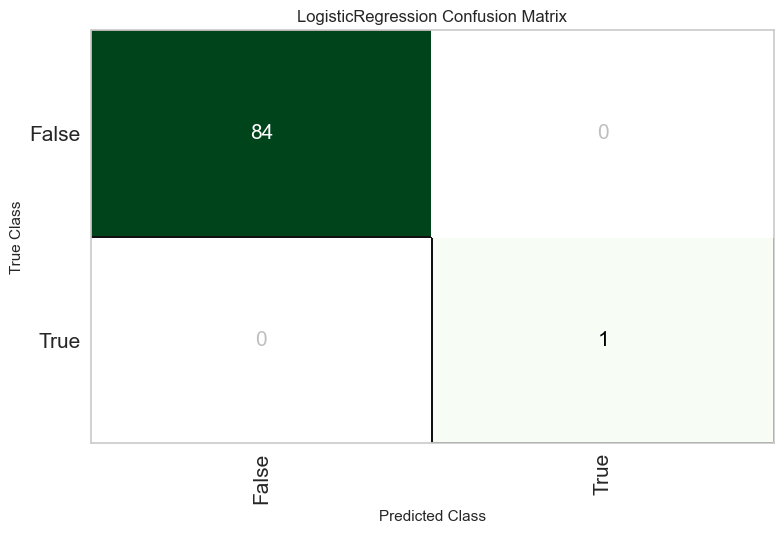

In [83]:
plot_model(estimator=lr, plot='confusion_matrix')

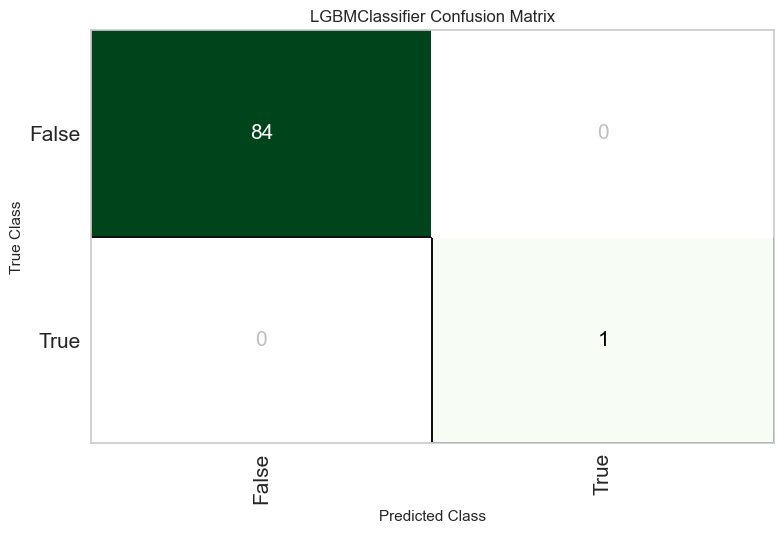

In [93]:
plot_model(estimator=lgbm, plot='confusion_matrix')

Observing feature plots between the 3 models.

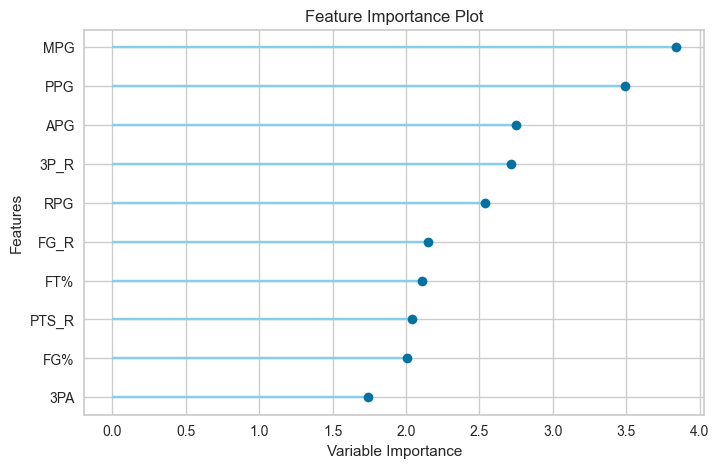

In [88]:
plot_model(estimator=svm, plot='feature')

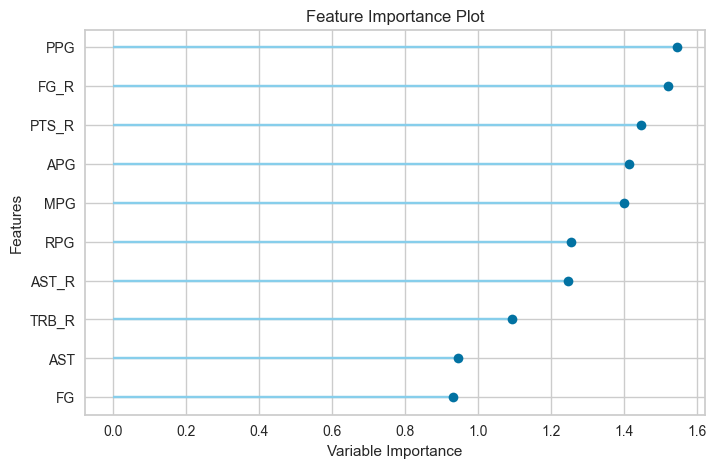

In [75]:
plot_model(estimator=lr, plot='feature')

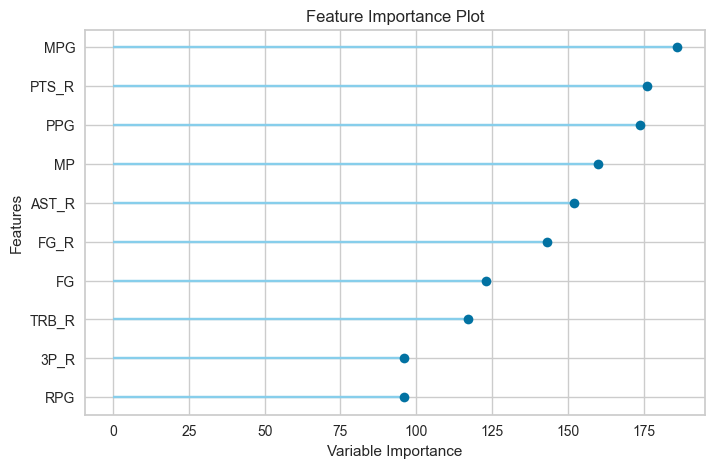

In [94]:
plot_model(estimator=lgbm, plot='feature')

The features that appear in all three models are:
  + MPG
  + PTS_R
  + PPG
  + FG_R
  + FG
  + RPG

It's surprising that shooting percentages or any 3-point related stats aren't a part of all 3 models' top 10 of feature importance.

# Hyperparameter Tuning

Tuning the Logistic Regression Model

In [113]:
lr = LogisticRegression()

solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]

grid = dict(solver=solvers,penalty=penalty,C=c_values)

In [114]:
lr_tuned = GridSearchCV(estimator=lr, param_grid=grid, scoring='precision', cv=5)
lr_tuned.fit(X, y)

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': [100, 10, 1.0, 0.1, 0.01], 'penalty': ['l2'],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear']},
             scoring='precision')

In [115]:
print("Best score: ", lr_tuned.best_score_)
print("Best estimators: ", lr_tuned.best_estimator_)

Best score:  0.8476190476190476
Best estimators:  LogisticRegression(solver='newton-cg')


In [116]:
preds = lr_tuned.predict(X_test)
preds = pd.DataFrame(preds, columns=["Prediction"], index=test.index)
comparison = pd.concat([test[["Player", "Team", "ROTY"]], preds], axis=1)
comparison = comparison.sort_values("ROTY", ascending=False)
comparison.head(1)

,Player,Team,ROTY,Prediction
1408,Paolo Banchero,Orlando Magic,True,True


Tuning the LGBM Model

In [75]:
lgbm = lgb.LGBMClassifier(boosting_type='dart', objective='binary', importance_type='gain')

num_leaves = [5, 20, 31, 60, 100]
learning_rates = [0.05, 0.01, 0.1, 0.2]
n_estimators = [50, 100, 150]
max_depths = [-1, 4, 7, 10]
feature_fractions = [0.4, 0.5, 0.6]


grid = dict(num_leaves=num_leaves,learning_rate=learning_rates,n_estimators=n_estimators, max_depth=max_depths, feature_fraction=feature_fractions)

In [76]:
lgbm_tuned = GridSearchCV(estimator=lgbm, param_grid=grid, scoring='precision', cv=5)
lgbm_tuned.fit(X, y)

[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Info] Number of positive: 36, number of negative: 1087
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5892
[LightGBM] [Info] Number of data points in the train set: 1123, number of used features: 62
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.032057 -> initscore=-3.407658
[LightGBM] [Info] Start training from score -3.407658
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [War

GridSearchCV(cv=5,
             estimator=LGBMClassifier(boosting_type='dart',
                                      importance_type='gain',
                                      objective='binary'),
             param_grid={'feature_fraction': [0.4, 0.5, 0.6],
                         'learning_rate': [0.05, 0.01, 0.1, 0.2],
                         'max_depth': [-1, 4, 7, 10],
                         'n_estimators': [50, 100, 150],
                         'num_leaves': [5, 20, 31, 60, 100]},
             scoring='precision')

In [77]:
print("Best score: ", lgbm_tuned.best_score_)
print("Best estimators: ", lgbm_tuned.best_estimator_)
print("Best parameters: ", lgbm_tuned.best_params_)

Best score:  0.7611904761904762
Best estimators:  LGBMClassifier(boosting_type='dart', feature_fraction=0.5,
               importance_type='gain', learning_rate=0.2, n_estimators=150,
               objective='binary')
Best parameters:  {'feature_fraction': 0.5, 'learning_rate': 0.2, 'max_depth': -1, 'n_estimators': 150, 'num_leaves': 31}


In [78]:
best_params = lgbm_tuned.best_params_

In [79]:
lgclf = lgb.LGBMClassifier(**best_params)
lgclf.fit(X, y)
preds = lgclf.predict(X_test)
preds = pd.DataFrame(preds, columns=["Prediction"], index=test.index)
comparison = pd.concat([test[["Player", "Team", "ROTY"]], preds], axis=1)
comparison = comparison.sort_values("ROTY", ascending=False)
comparison.head(5)

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Info] Number of positive: 45, number of negative: 1359
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6069
[LightGBM] [Info] Number of data points in the train set: 1404, number of used features: 64
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.032051 -> initscore=-3.407842
[LightGBM] [Info] Start training from score -3.407842
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

,Player,Team,ROTY,Prediction
1408,Paolo Banchero,Orlando Magic,True,True
1404,Ochai Agbaji,Utah Jazz,False,False
1431,Ousmane Dieng,Oklahoma City Thunder,False,False
1425,David Roddy,Memphis Grizzlies,False,False
1426,Johnny Davis,Washington Wizards,False,False


In [38]:
preds = lgbm_tuned.predict(X_test)
preds = pd.DataFrame(preds, columns=["Prediction"], index=test.index)
comparison = pd.concat([test[["Player", "Team", "ROTY"]], preds], axis=1)
comparison = comparison.sort_values("ROTY", ascending=False)
comparison.head(5)

[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4


,Player,Team,ROTY,Prediction
1408,Paolo Banchero,Orlando Magic,True,True
1404,Ochai Agbaji,Utah Jazz,False,False
1431,Ousmane Dieng,Oklahoma City Thunder,False,False
1425,David Roddy,Memphis Grizzlies,False,False
1426,Johnny Davis,Washington Wizards,False,False


The LGBM model appears to be the strongest of the 2 models. This will be the one I continue to test on. I can analyze and diagnose the model further to determine any extra data preprocessing or feature engineering I can perform on the main dataset.

In [80]:
split_importance = lgbm_tuned.best_estimator_.feature_importances_
feature_names = X_test.columns

importance_df = pd.DataFrame({'Feature': feature_names, 'Gain': split_importance})
importance_df = importance_df.sort_values(by='Gain', ascending=True)
importance_df.head(50)

,Feature,Gain
36,Tm_BRK,0.000000e+00
38,Tm_CHH,0.000000e+00
39,Tm_CHI,0.000000e+00
40,Tm_CHO,0.000000e+00
47,Tm_IND,0.000000e+00
48,Tm_KCK,0.000000e+00
50,Tm_LAL,0.000000e+00
52,Tm_MIA,0.000000e+00
56,Tm_NOH,0.000000e+00
37,Tm_CHA,0.000000e+00


In [81]:
fig = px.bar(importance_df, x="Gain", y="Feature", orientation='h',title="LightGBM Feature Importance (Gain)", template='simple_white')
fig.update_traces(width=0.5)
fig.update_layout(width=1000,height=1000)
fig.show()

In [41]:
columns_to_drop = ["Player", "Debut", "Team"]
num_cutoff = stats_final.drop(columns_to_drop, axis=1)

In [42]:
fig = px.imshow(num_cutoff.corr()[['ROTY']].sort_values(by='ROTY', ascending=False),
                zmin=-1,
                zmax=1
                )
fig.update_layout(width=1000,height=1000)
fig.show()

In [43]:
fig = px.imshow(num_cutoff.corr(),
                zmin=-1,
                zmax=1
                )
fig.update_layout(width=1000,height=1000)
fig.show()

Tuning an XGBRegressor model to predict shares.

In [85]:
rX = train[features]
rY = train["Share"]

rX_test = test[features]

In [86]:
xgr = XGBRegressor(boosting_type='dart', objective='reg:linear', device='gpu', importance_type='gain',eval_metric=mean_absolute_error)

n_estimators = [50, 100, 150]
learning_rates = [0.05, 0.01, 0.1, 0.2]
max_depths = [4, 7, 10]

grid = dict(learning_rate=learning_rates,n_estimators=n_estimators, max_depth=max_depths)

In [87]:
xgr_tuned = GridSearchCV(estimator=xgr, param_grid=grid, scoring='accuracy', cv=5)
xgr_tuned.fit(rX, rY)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    boosting_type='dart', callbacks=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device='gpu',
                                    early_stopping_rounds=None,
                                    enable_categorical=False,
                                    eval_metric=<function mean_absolute_error at 0x00000170B00951C0>,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, imp...
                                    max_cat_threshold=None,
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None, ...),
             param_grid={'learning_rate': [0.05, 0.01, 0.1, 0.2],
                         'max_depth': [4, 7, 10],
                         'n_estimators': [50, 100, 150]},
             scoring='accuracy')

In [88]:
print("Best score: ", xgr_tuned.best_score_)
print("Best estimators: ", xgr_tuned.best_estimator_)
print("Best parameters: ", xgr_tuned.best_params_)

Best score:  nan
Best estimators:  XGBRegressor(base_score=None, booster=None, boosting_type='dart',
             callbacks=None, colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device='gpu', early_stopping_rounds=None,
             enable_categorical=False,
             eval_metric=<function mean_absolute_error at 0x00000170B00951C0>,
             feature_types=None, gamma=None, grow_policy=None,
             importance_type='gain', interaction_constraints=None,
             learning_rate=0.05, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=4,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=50,
             n_jobs=None, num_parallel_tree=None, ...)
Best parameters:  {'learning_rate': 0.05, 'max_depth': 4, 'n_estimators': 50}


In [90]:
best_params = xgr_tuned.best_params_

reg = XGBRegressor(**best_params)
reg.fit(X, y)
preds = reg.predict(rX_test)

preds = pd.DataFrame(preds, columns=["Predictions"], index=test.index)
comparison_xgb = pd.concat([test[["Player", "ROTY", "Year", "Share"]], preds], axis=1)
comparison_xgb = comparison_xgb.sort_values("ROTY", ascending=False)
comparison_xgb["Rank"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_xgb = comparison_xgb.sort_values("Predictions", ascending=False)
comparison_xgb["Predicted Decision"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_xgb.head(10)

,Player,ROTY,Year,Share,Predictions,Rank,Predicted Decision
1408,Paolo Banchero,True,2023,0.988,0.552569,1,1
1418,Bennedict Mathurin,False,2023,0.054,0.106577,33,2
1414,Jaden Ivey,False,2023,0.006,0.089441,28,3
1435,RaiQuan Gray,False,2023,0.000,0.073375,14,4
1429,Jabari Smith Jr.,False,2023,0.000,0.029803,8,5
1419,Andrew Nembhard,False,2023,0.000,0.020853,34,6
1432,Jalen Williams,False,2023,0.482,0.016648,10,7
1434,Keegan Murray,False,2023,0.042,0.014863,13,8
1413,Jalen Duren,False,2023,0.000,0.010058,21,9
1438,Bryce McGowens,False,2023,0.000,0.006966,17,10


In [91]:
gain_importance = reg.feature_importances_
feature_names = X_test.columns

importance_df = pd.DataFrame({'Feature': feature_names, 'Gain': gain_importance})
importance_df = importance_df.sort_values(by='Gain', ascending=True)
importance_df.head(10)

,Feature,Gain
36,Tm_BRK,0.0
37,Tm_CHA,0.0
38,Tm_CHH,0.0
39,Tm_CHI,0.0
42,Tm_DAL,0.0
44,Tm_DET,0.0
45,Tm_GSW,0.0
46,Tm_HOU,0.0
47,Tm_IND,0.0
48,Tm_KCK,0.0


In [96]:
fig = px.bar(importance_df, x="Gain", y="Feature", orientation='h',title="XGB Regressor Feature Importance (Gain)", template='simple_white')
fig.update_traces(width=0.5)
fig.update_layout(width=1000,height=1000)
fig.show()

# Predicting the ROTY for the 2023-2024 Season

In [82]:
train2024 = stats_final[stats_final["Year"] < 2024]

test_2024 = stats_final[stats_final["Year"] == 2024]
del test_2024["ROTY"]

In [83]:
newX = train2024[features]
newY = train2024["ROTY"]

newX_test = test_2024[features]

In [84]:
preds = lgbm_tuned.predict(newX_test)
preds = pd.DataFrame(preds, columns=["Prediction"], index=test_2024.index)
comparison = pd.concat([test_2024[["Player", "Team"]], preds], axis=1)
comparison = comparison.sort_values("Prediction", ascending=False)
comparison.head(10)

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5


,Player,Team,Prediction
1459,Chet Holmgren,Oklahoma City Thunder,True
1450,Victor Wembanyama,San Antonio Spurs,True
1440,Toumani Camara,Portland Trail Blazers,False
1455,Jordan Hawkins,New Orleans Pelicans,False
1466,Cam Whitmore,Houston Rockets,False
1465,Amen Thompson,Houston Rockets,False
1464,Jaime Jaquez Jr.,Miami Heat,False
1463,Brandin Podziemski,Golden State Warriors,False
1462,Trayce Jackson-Davis,Golden State Warriors,False
1461,Gregory Jackson II,Memphis Grizzlies,False


In [20]:
rTrain_2024 = stats_final[stats_final["Year"] < 2024]

rTest_2024 = stats_final[stats_final["Year"] == 2024]
#del rTest_2024["MVP"]

In [21]:
newrX = rTrain_2024[features]
newrY = rTrain_2024["Share"]

newrX_test = rTest_2024[features]

In [97]:
reg = XGBRegressor(**best_params)
reg.fit(newrX, newrY)
preds = reg.predict(newrX_test)

preds = pd.DataFrame(preds, columns=["Predictions"], index=rTest_2024.index)
comparison_xgb = pd.concat([rTest_2024[["Player", "Team"]], preds], axis=1)
#comparison_xgb = comparison_xgb.sort_values("Share", ascending=False)
#comparison_xgb["Rank"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_xgb = comparison_xgb.sort_values("Predictions", ascending=False)
comparison_xgb["Predicted Decision"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_xgb.head(10)

,Player,Team,Predictions,Predicted Decision
1459,Chet Holmgren,Oklahoma City Thunder,0.519126,1
1450,Victor Wembanyama,San Antonio Spurs,0.417818,2
1456,Keyonte George,Utah Jazz,0.344257,3
1464,Jaime Jaquez Jr.,Miami Heat,0.331192,4
1441,Scoot Henderson,Portland Trail Blazers,0.264876,5
1463,Brandin Podziemski,Golden State Warriors,0.200139,6
1455,Jordan Hawkins,New Orleans Pelicans,0.199189,7
1452,Dereck Lively II,Dallas Mavericks,0.147192,8
1443,Brandon Miller,Charlotte Hornets,0.126463,9
1460,Cason Wallace,Oklahoma City Thunder,0.120157,10


In [22]:
extree = ExtraTreesRegressor(criterion="absolute_error", n_estimators=500, min_samples_leaf=10,max_features=4)

In [23]:
extree.fit(newrX, newrY)
preds = extree.predict(newrX_test)

preds = pd.DataFrame(preds, columns=["Predictions"], index=rTest_2024.index)
comparison_etr = pd.concat([rTest_2024[["Player", "Team"]], preds], axis=1)
#comparison_xgb = comparison_xgb.sort_values("Share", ascending=False)
#comparison_xgb["Rank"] = list(range(1, comparison_xgb.shape[0]+1))
comparison_etr = comparison_etr.sort_values("Predictions", ascending=False)
comparison_etr["Predicted Decision"] = list(range(1, comparison_etr.shape[0]+1))
comparison_etr.head(5)

,Player,Team,Predictions,Predicted Decision
1450,Victor Wembanyama,San Antonio Spurs,0.164153,1
1459,Chet Holmgren,Oklahoma City Thunder,0.149452,2
1464,Jaime Jaquez Jr.,Miami Heat,0.112000,3
1443,Brandon Miller,Charlotte Hornets,0.099647,4
1441,Scoot Henderson,Portland Trail Blazers,0.053015,5


# Conclusion

The model actually produces a tie here, which has happened before. The award was shared by Elton Brand and Steve Francis (2000), Grant Hill and Jason Kidd (1995) and Dave Cowens and Geoff Petrie (1971). 